In [1]:
#statsmodels https://qiita.com/yubais/items/24f49df99b487fdc374d

In [2]:
import pandas as pd
import pandas_profiling as pdp
import seaborn as sns
import statsmodels.api as sm
import numpy as np
import matplotlib.pyplot as plt
from  matplotlib.pyplot import scatter
import statsmodels.formula.api as smf
import statsmodels.stats.api as sms
import matplotlib.pyplot as plt
from statsmodels.compat import lzip
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error
import math
from sklearn.metrics import mean_absolute_error
import pyper as pr
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import GroupKFold
from statsmodels.sandbox.regression.predstd import wls_prediction_std
import matplotlib.pyplot as plt
from statsmodels.graphics.api import abline_plot
from sklearn.model_selection import train_test_split
import numpy as np

import matplotlib
matplotlib.use('Agg')

import plotly
plotly.offline.init_notebook_mode(connected=False)

import plotly.plotly as py
import plotly.graph_objs as go

%matplotlib inline

In [3]:
data = pd.read_csv("rawdata.csv",encoding = "shift_jis")
print(data.shape)
display(data.head())

(700, 3)


,subject,phase_diff,magnitude
0,永井君,0,5.5
1,永井君,20,4.5
2,永井君,40,4.0
3,永井君,60,5.0
4,永井君,80,4.5


In [4]:
pdp.ProfileReport(data)


Number of variables,3
Number of observations,700
Total Missing (%),0.0%
Total size in memory,16.5 KiB
Average record size in memory,24.1 B
Numeric,2
Categorical,1
Boolean,0
Date,0
Text (Unique),0
Rejected,0


In [5]:
valid_subject = ["上島君", "志村君", "仙石君", "渡邉君", "梅津君", "横山君", "向畑君", "浅田君", "池田君", "岩崎君"]
data = data.loc[data["subject"].isin(valid_subject),:].reset_index(drop = True)
print(data.shape)
data

(600, 3)


,subject,phase_diff,magnitude
0,横山君,0,6.0
1,横山君,20,5.0
2,横山君,40,3.5
3,横山君,60,1.0
4,横山君,80,2.0
5,横山君,100,3.0
6,横山君,120,5.0
7,横山君,140,2.5
8,横山君,160,3.0
9,横山君,180,2.0


In [6]:
d_to_r = lambda x: math.radians(x)
data.loc[:,"phase_diff_radian"] = data.loc[:,"phase_diff"].apply(d_to_r)
data.head()

,subject,phase_diff,magnitude,phase_diff_radian
0,横山君,0,6.0,0.000000
1,横山君,20,5.0,0.349066
2,横山君,40,3.5,0.698132
3,横山君,60,1.0,1.047198
4,横山君,80,2.0,1.396263


# 散布図


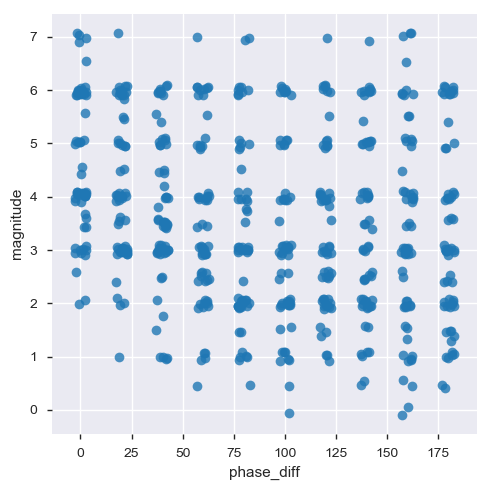

In [7]:
g = sns.lmplot(x = "phase_diff", y = "magnitude", data = data, fit_reg = False, x_jitter = 3 , y_jitter = 0.1)
g

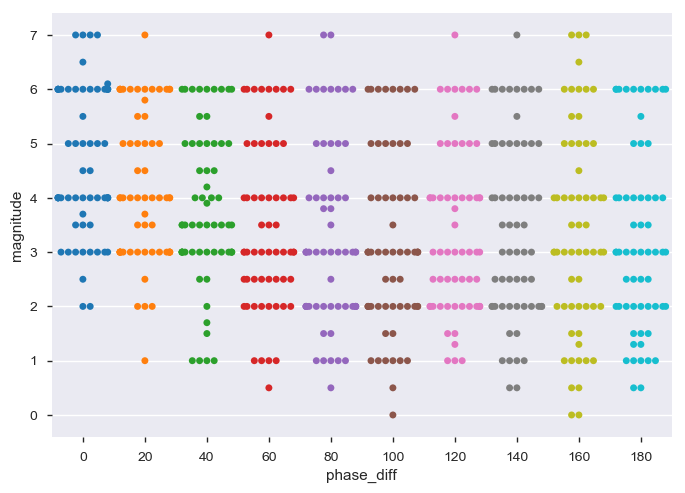

In [8]:
g = sns.swarmplot(x = "phase_diff", y = "magnitude", data = data)


[Text(0,0.5,'Magnitude value'), Text(0.5,0,'phase diff [deg]')]

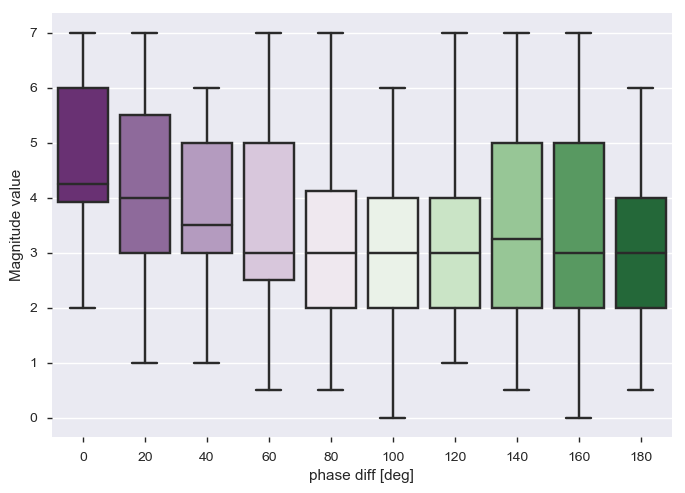

In [9]:
ax = sns.boxplot(x='phase_diff', y="magnitude",data=data, palette="PRGn")
ax.set(xlabel='phase diff [deg]', ylabel='Magnitude value')


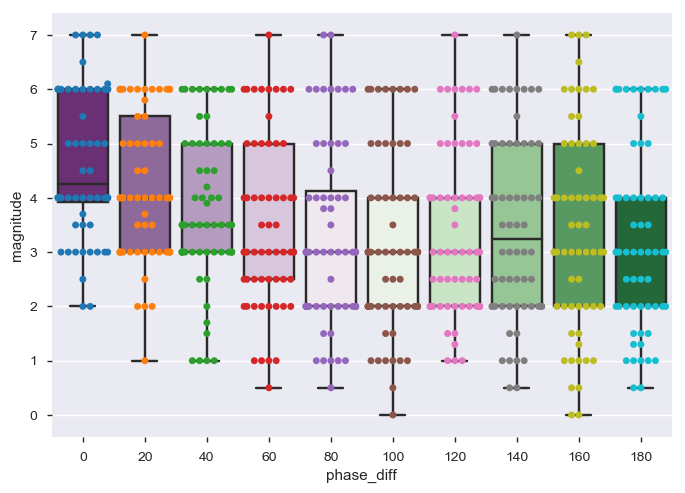

In [10]:
g = sns.swarmplot(x = "phase_diff", y = "magnitude", data = data)
sns.boxplot(x='phase_diff', y="magnitude",data=data, palette="PRGn")

phase_diff = 0


C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning:

Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.



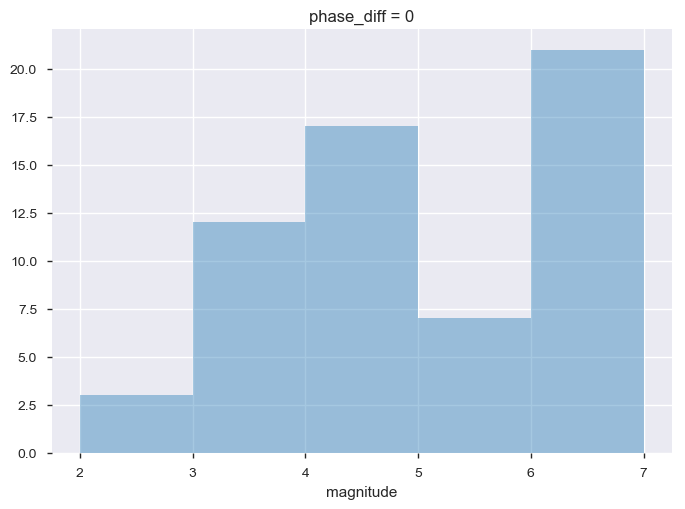

phase_diff = 20


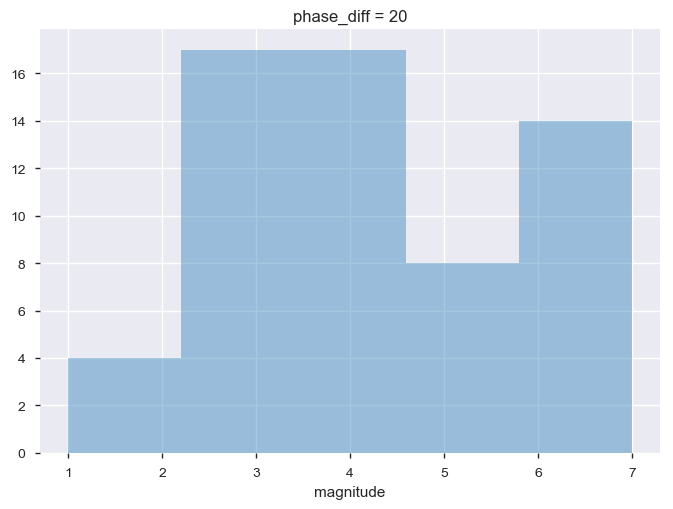

phase_diff = 40


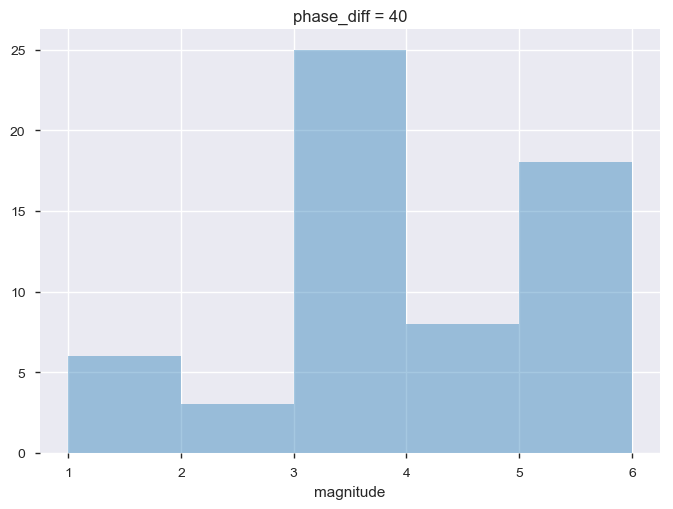

phase_diff = 60


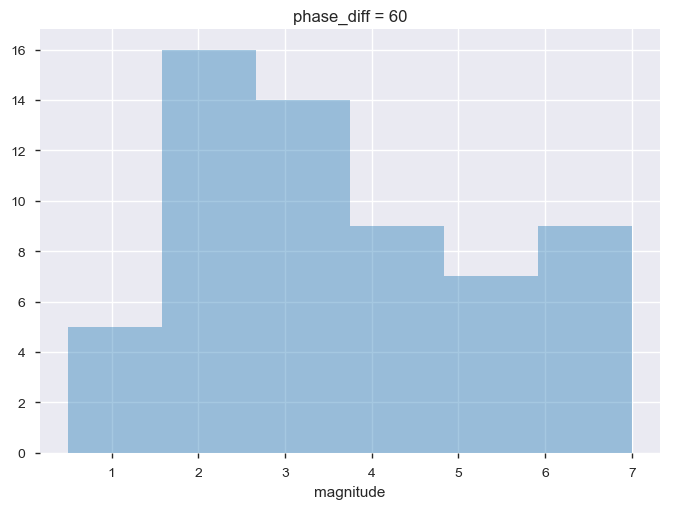

phase_diff = 80


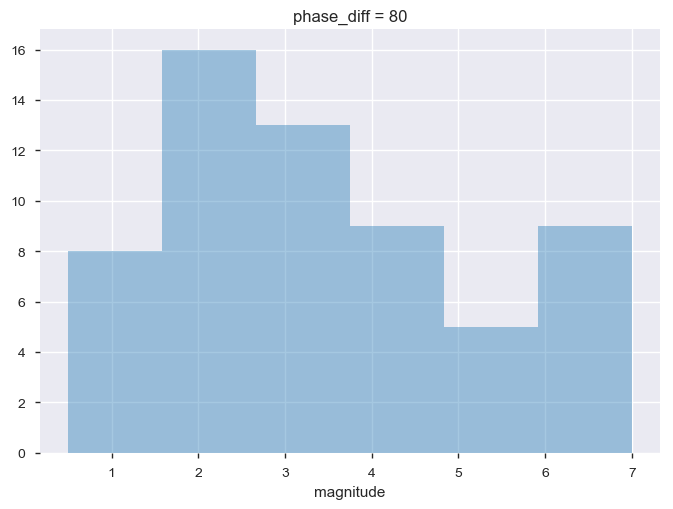

phase_diff = 100


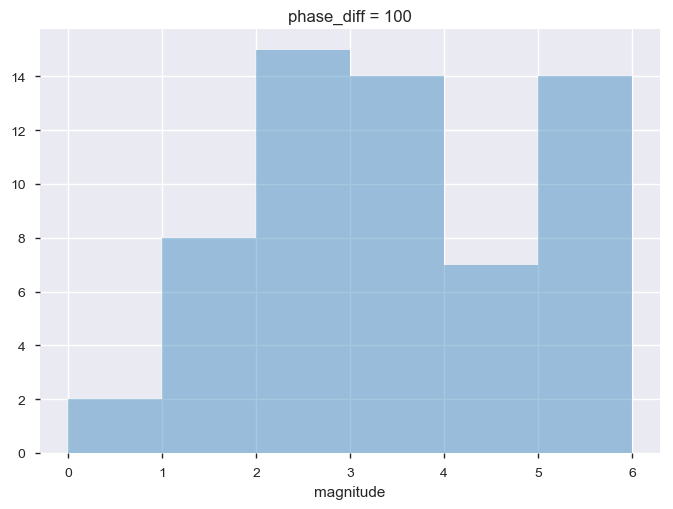

phase_diff = 120


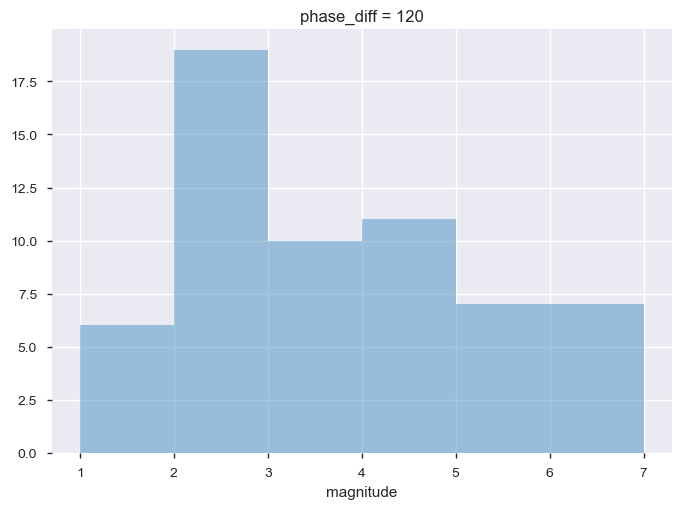

phase_diff = 140


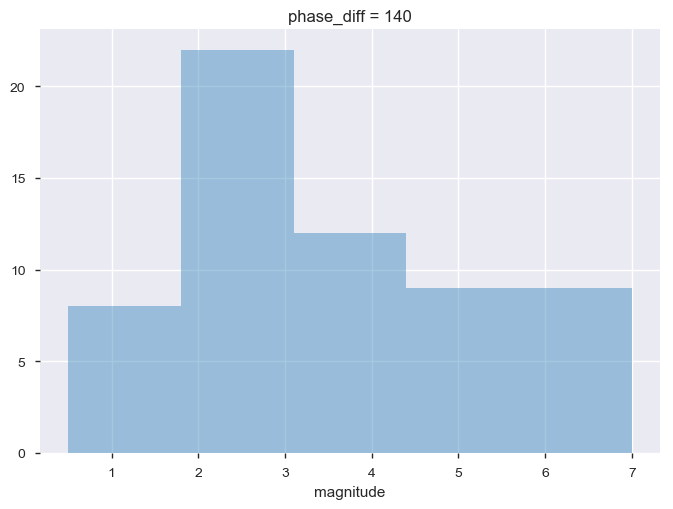

phase_diff = 160


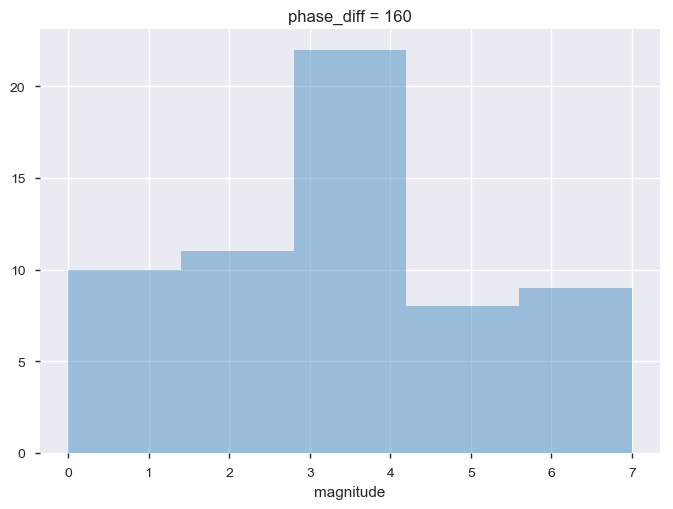

phase_diff = 180


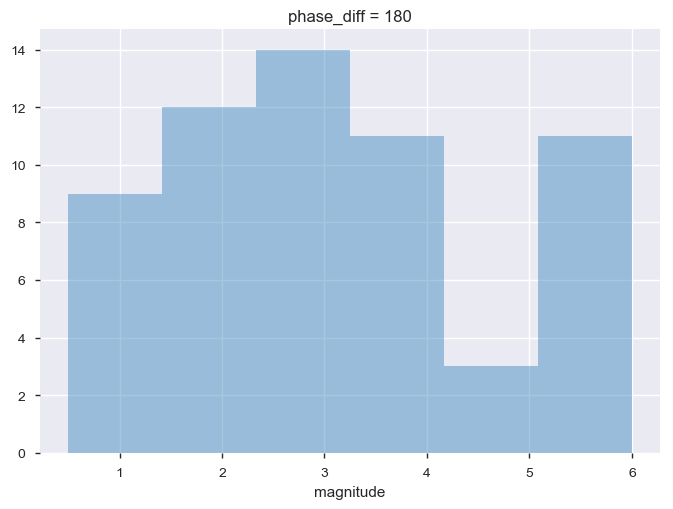

In [11]:
for phase_diff in data["phase_diff"].unique():
    print("phase_diff =", phase_diff)
    plt.figure()
    sns.distplot(data.loc[data["phase_diff"] == phase_diff,"magnitude"], kde=False)
    plt.title("phase_diff = "+ str(phase_diff))
    plt.show()

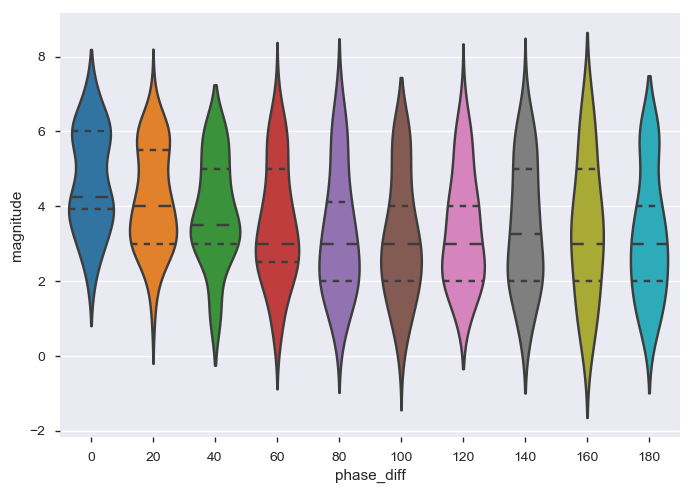

In [12]:
#kde?
sns.violinplot(x="phase_diff", y="magnitude", data = data, split=True,
               inner="quart")

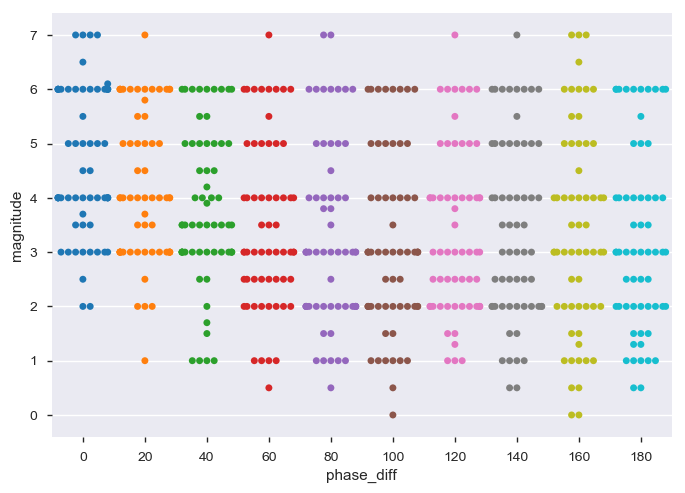

In [13]:
sns.swarmplot(x="phase_diff", y = "magnitude" , data =data)

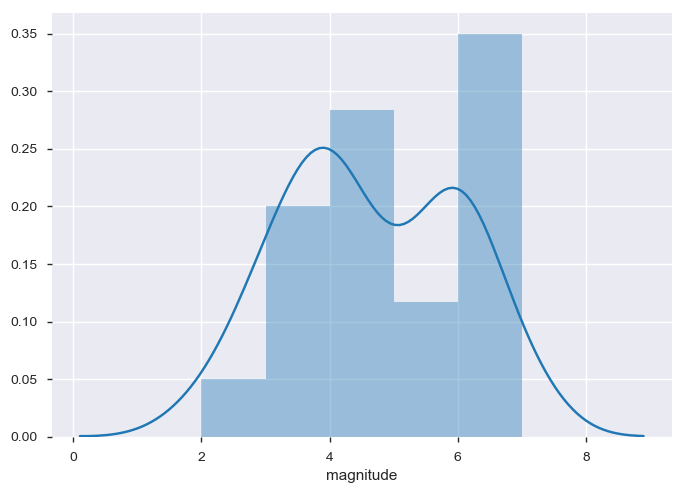

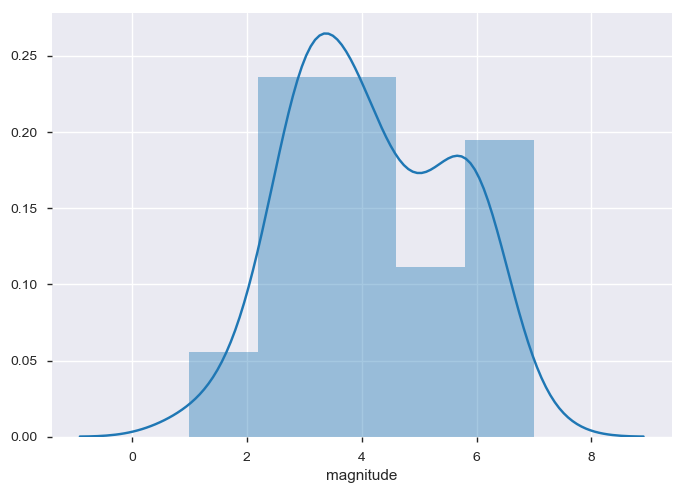

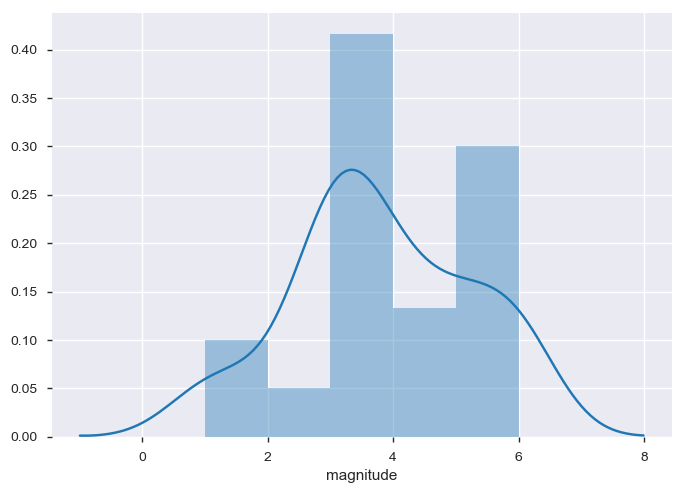

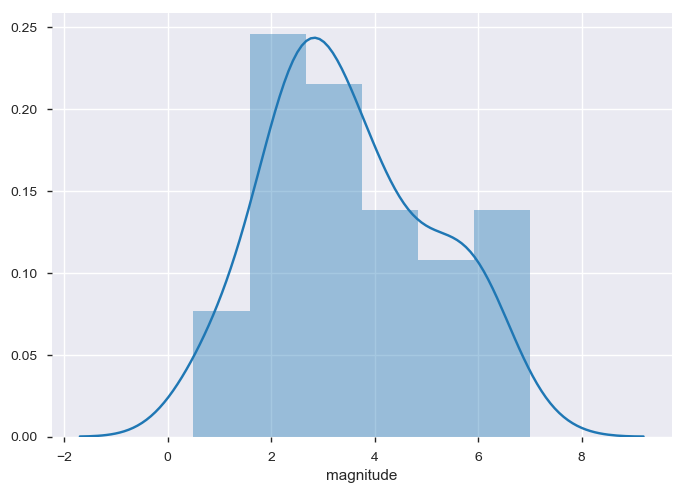

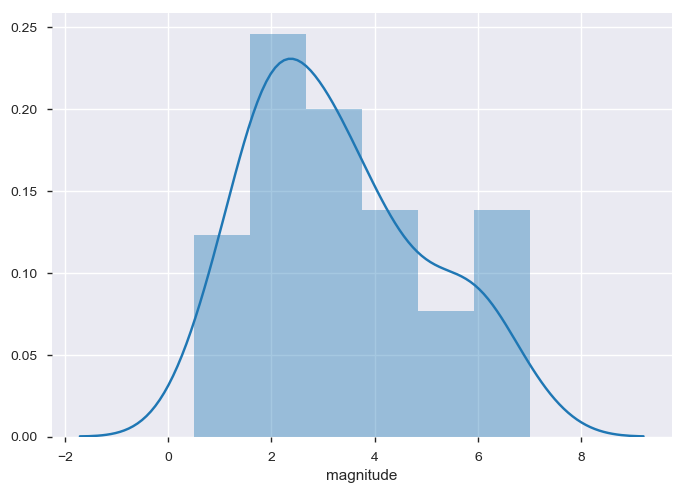

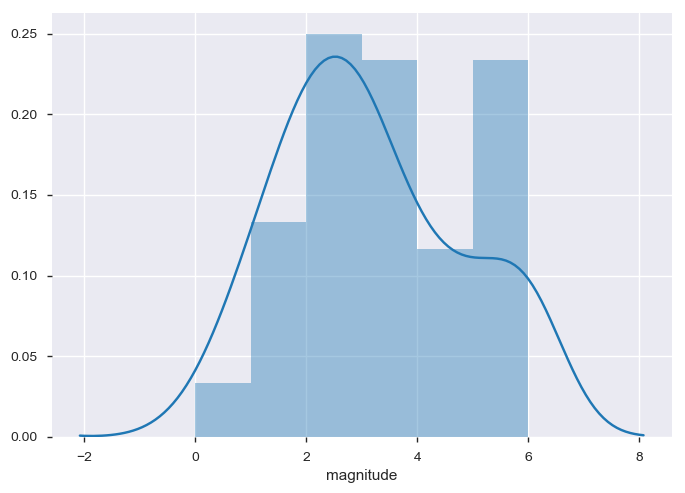

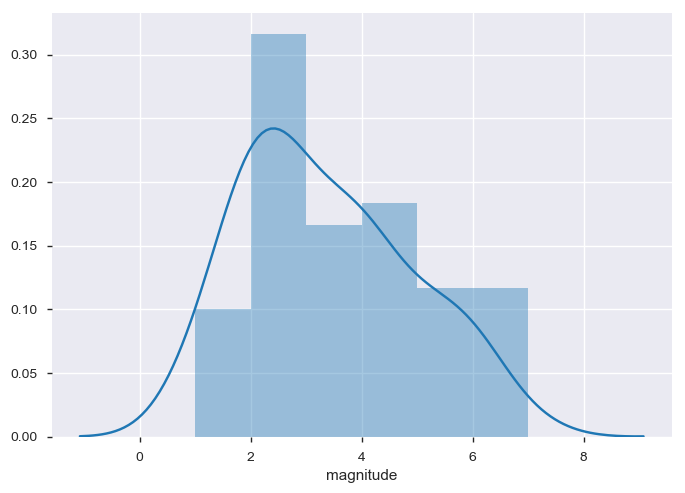

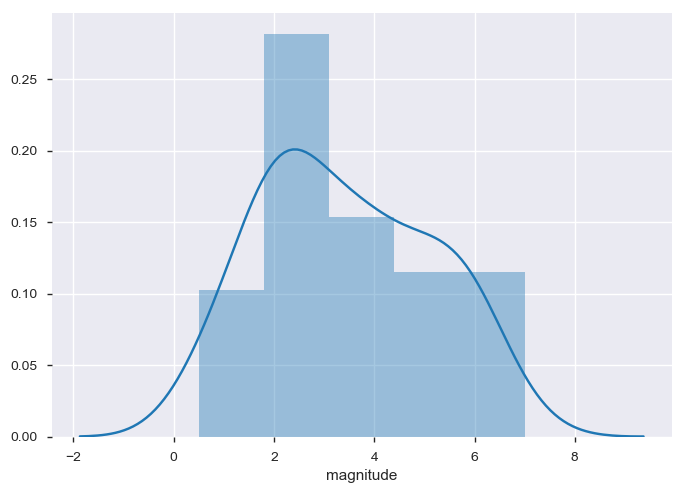

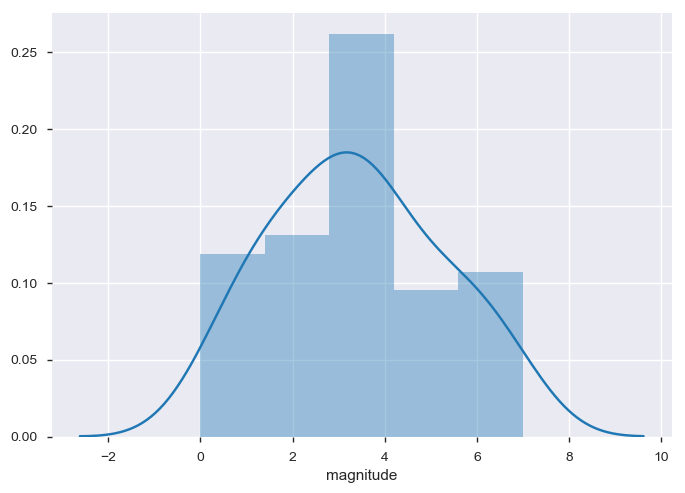

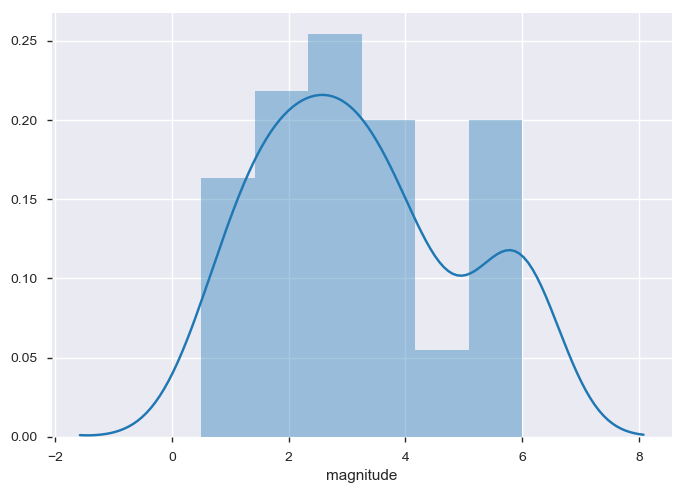

In [14]:
for phase in data["phase_diff"].unique():
    plt.figure()
    sns.distplot( data.loc[data["phase_diff"] == phase,"magnitude"])
    plt.plot()

In [15]:
subject_list = data["subject"].unique()
subject_list

array(['横山君', '岩崎君', '向畑君', '志村君', '上島君', '仙石君', '浅田君', '池田君', '渡邉君',
       '梅津君'], dtype=object)

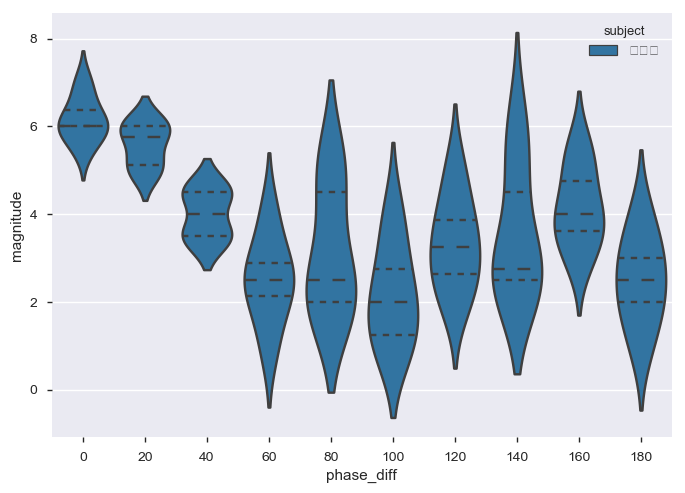

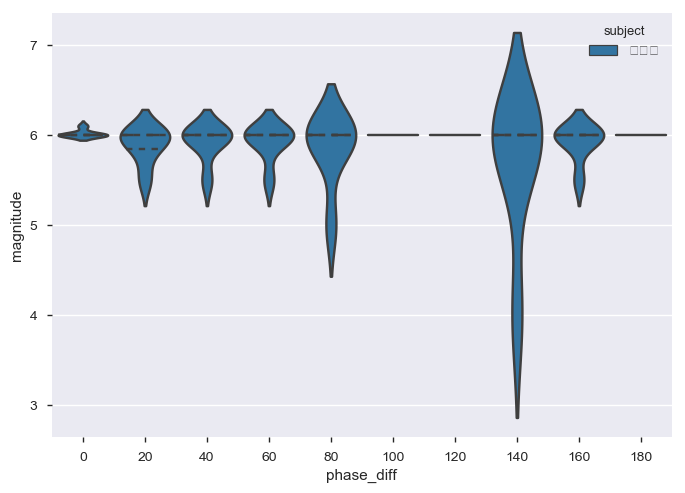

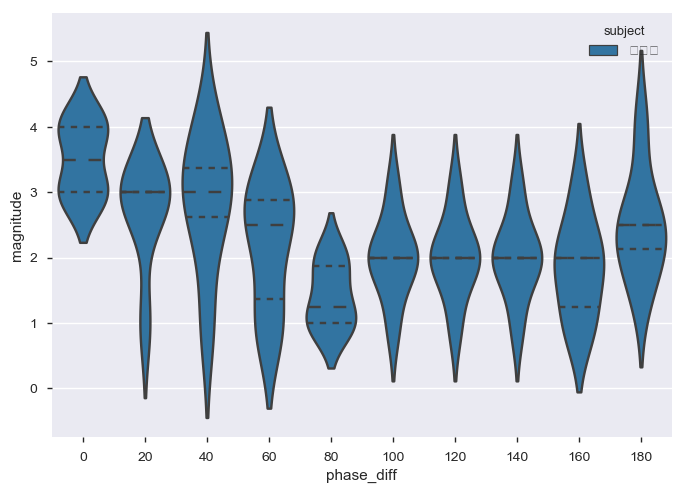

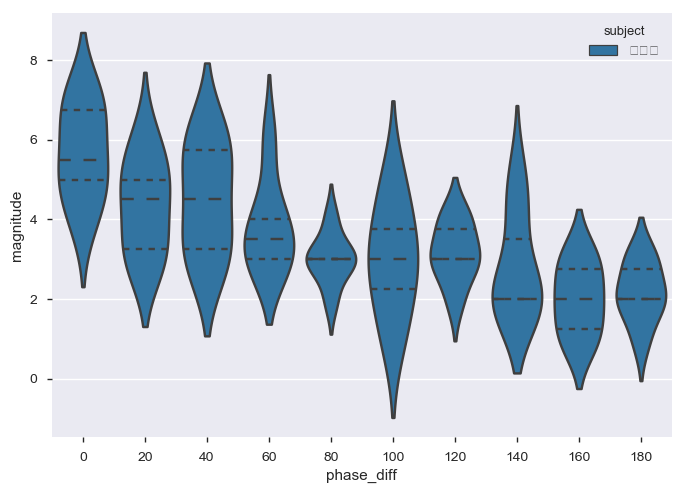

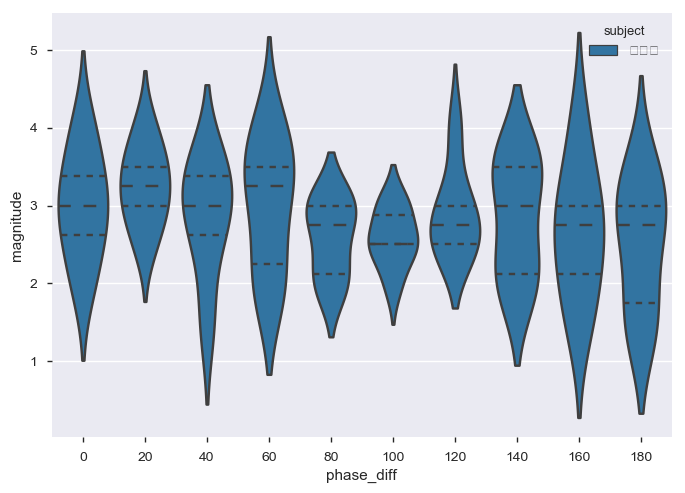

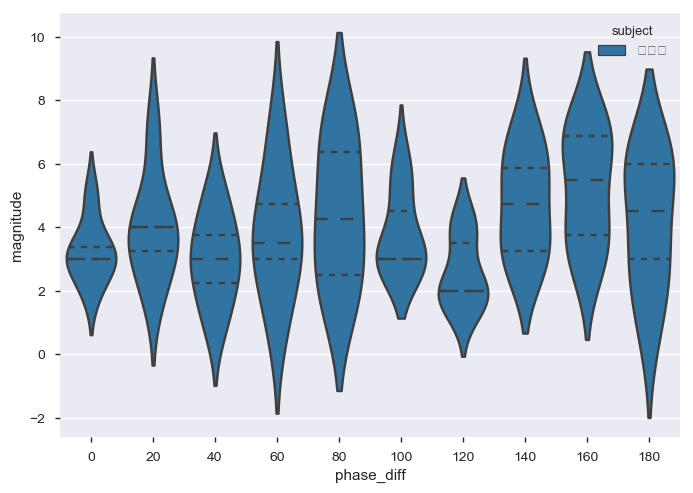

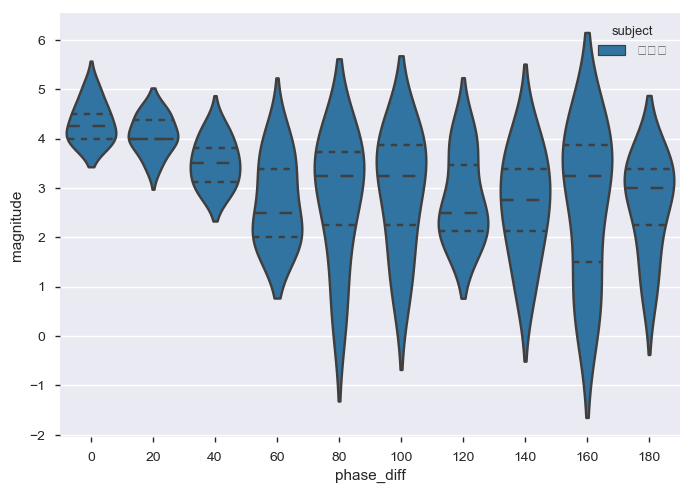

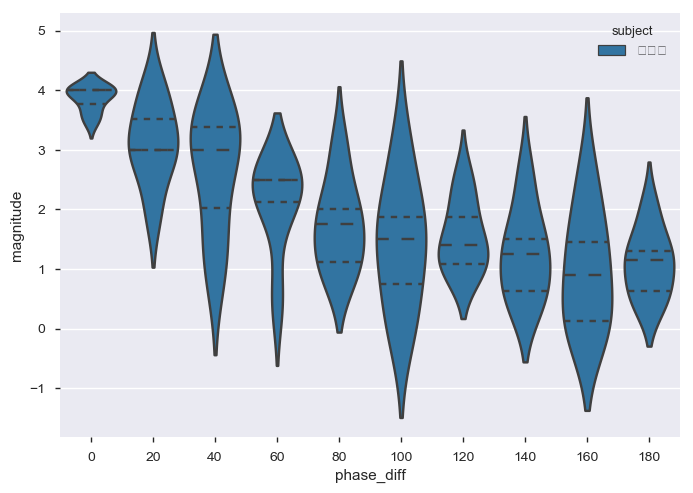

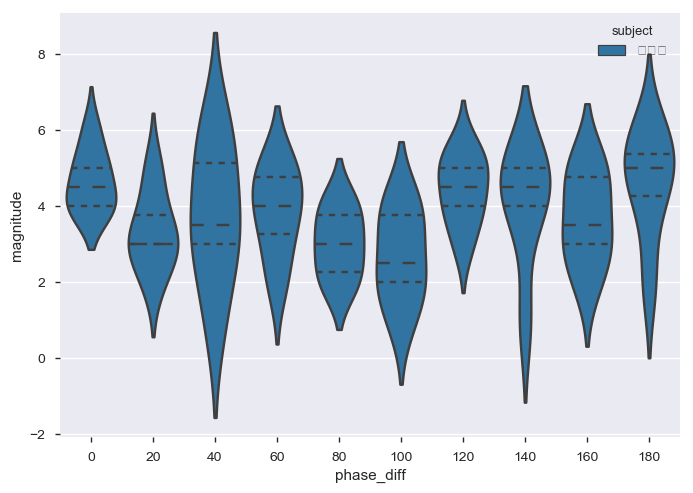

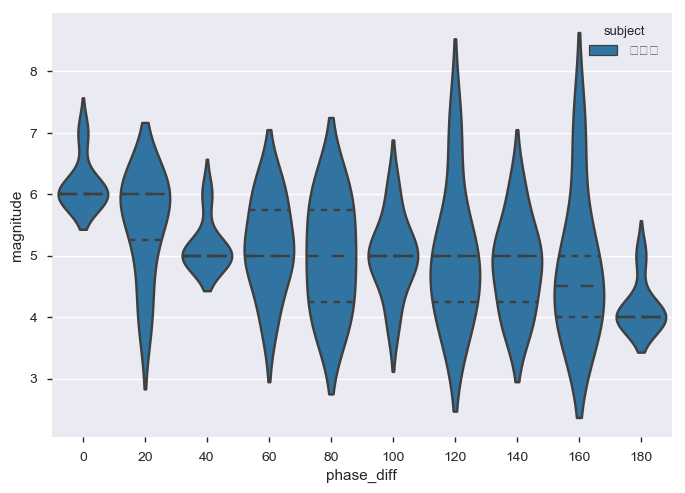

In [16]:
subject_list = data["subject"].unique()

for subject in subject_list:
    sns.violinplot(x="phase_diff", y="magnitude", hue = "subject", data = data.loc[data["subject"]==subject,:],
               inner="quart")
    plt.show()

,magnitude,phase_diff_radian,phase_diff
phase_diff,,,
0,4.663333,0.000000,0
20,4.175000,0.349066,20
40,3.813333,0.698132,40
60,3.508333,1.047198,60
80,3.293333,1.396263,80
100,3.158333,1.745329,100
120,3.376667,2.094395,120
140,3.441667,2.443461,140
160,3.396667,2.792527,160


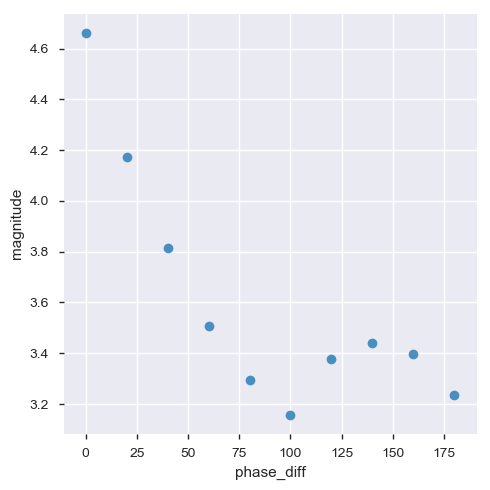

In [17]:
#phase_diffに沿った平均
phase_diff_mean = data.groupby(["phase_diff"]).mean()
phase_diff_mean.loc[:,"phase_diff"] = phase_diff_mean.index
display(phase_diff_mean)
sns.lmplot(x = "phase_diff", y = "magnitude", data = phase_diff_mean, fit_reg = None)
#data.groupby(["subject", "phase_diff"]).var()

,magnitude,phase_diff_radian,phase_diff
phase_diff,,,
0,1.832192,0.0,0
20,1.855805,0.0,20
40,2.012701,0.0,40
60,2.453319,0.0,60
80,2.807073,0.0,80
100,2.682133,0.0,100
120,2.318090,0.0,120
140,2.865184,0.0,140
160,3.486429,0.0,160


Text(1.69444,0.5,'var_of_magnitude')

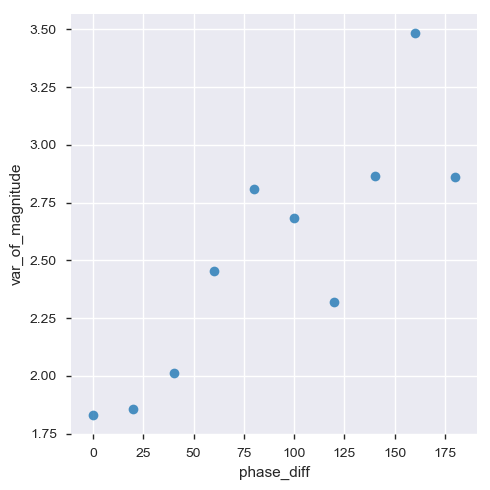

In [18]:
#phase_diffに沿った分散
phase_diff_var = data.groupby(["phase_diff"]).var()
phase_diff_var.loc[:,"phase_diff"] = phase_diff_var.index
display(phase_diff_var)
sns.lmplot(x = "phase_diff", y = "magnitude", data = phase_diff_var, fit_reg = None)
plt.ylabel("var_of_magnitude")
#data.groupby(["subject", "phase_diff"]).var()

# 被験者ごとの分散の変化


magnitude  phase_diff_radian  phase_diff subject
subject phase_diff                                                  
上島君     0            0.500000                0.0           0     上島君
        20           0.275000                0.0          20     上島君
        40           0.566667                0.0          40     上島君
        60           0.700000                0.0          60     上島君
        80           0.241667                0.0          80     上島君
        100          0.141667                0.0         100     上島君
        120          0.341667                0.0         120     上島君
        140          0.566667                0.0         140     上島君
        160          0.766667                0.0         160     上島君
        180          0.700000                0.0         180     上島君
仙石君     0            0.975000                0.0           0     仙石君
        20           2.800000                0.0          20     仙石君
        40           2.000000                0.0          40     仙石君
        60           4.166667                0.0          60     仙石君
        80           5.041667                0.0          80     仙石君
        100          1.766667                0.0         100     仙石君
        120          1.241667                0.0         120     仙石君
        140          2.775000                0.0         140     仙石君
        160          3.275000                0.0         160     仙石君
        180          4.566667                0.0         180     仙石君
向畑君     0            0.300000                0.0           0     向畑君
        20           0.666667                0.0          20     向畑君
        40           1.066667                0.0          40     向畑君
        60           0.866667                0.0          60     向畑君
        80           0.241667                0.0          80     向畑君
        100          0.400000                0.0         100     向畑君
        120          0.400000                0.0         120     向畑君
        140          0.400000                0.0         140     向畑君
        160          0.566667                0.0         160     向畑君
        180          0.700000                0.0         180     向畑君
...                       ...                ...         ...     ...
池田君     0            0.046667                0.0           0     池田君
        20           0.481667                0.0          20     池田君
        40           1.061667                0.0          40     池田君
        60           0.641667                0.0          60     池田君
        80           0.575000                0.0          80     池田君
        100          1.141667                0.0         100     池田君
        120          0.355000                0.0         120     池田君
        140          0.575000                0.0         140     池田君
        160          0.966667                0.0         160     池田君
        180          0.324000                0.0         180     池田君
浅田君     0            0.166667                0.0           0     浅田君
        20           0.141667                0.0          20     浅田君
        40           0.229667                0.0          40     浅田君
        60           0.775000                0.0          60     浅田君
        80           1.690667                0.0          80     浅田君
        100          1.441667                0.0         100     浅田君
        120          0.780000                0.0         120     浅田君
        140          1.166667                0.0         140     浅田君
        160          2.366667                0.0         160     浅田君
        180          0.966667                0.0         180     浅田君
渡邉君     0            0.666667                0.0           0     渡邉君
        20           1.066667                0.0          20     渡邉君
        40           3.375000                0.0          40     渡邉君
        60           1.366667                0.0          60     渡邉君
        80           0.800000                0.0          80     渡邉君
        100       

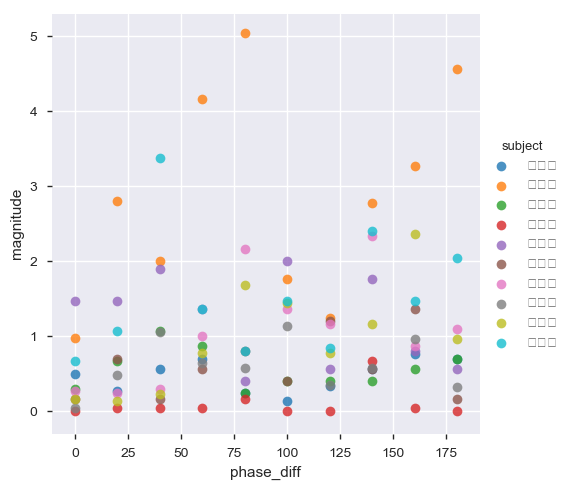

In [19]:
sub_phase_diff_var = data.groupby(["subject", "phase_diff"]).var()
sub_phase_diff_var.loc[:,"phase_diff"] = sub_phase_diff_var.index.get_level_values(1)
sub_phase_diff_var.loc[:,"subject"] = sub_phase_diff_var.index.get_level_values(0)
display(sub_phase_diff_var)
sns.lmplot(x = "phase_diff", y = "magnitude", data = sub_phase_diff_var, hue = "subject", fit_reg = None)

# 線形回帰

In [20]:
#一次式
results1 = smf.ols("magnitude ~ phase_diff", data = data).fit()
display(results1.summary())

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              magnitude   R-squared:                       0.048
Model:                            OLS   Adj. R-squared:                  0.047
Method:                 Least Squares   F-statistic:                     30.41
Date:                Mon, 21 Jan 2019   Prob (F-statistic):           5.20e-08
Time:                        16:03:09   Log-Likelihood:                -1132.3
No. Observations:                 600   AIC:                             2269.
Df Residuals:                     598   BIC:                             2277.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      4.1705      0.121     34.355      0.000       3.932       4.409
phase_diff    -0.0063      0.001     -5.515      0.000      -0.009      -0.004
==============================================================================
Omnibus:                       48.026   Durbin-Watson:                   0.695
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               20.709
Skew:                           0.237   Prob(JB):                     3.18e-05
Kurtosis:                       2.223   Cond. No.                         198.
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [21]:
results1.resid

0      1.829515
1      0.954919
2     -0.419677
3     -2.794273
4     -1.668869
5     -0.543465
6      1.581939
7     -0.792657
8     -0.167253
9     -1.041848
10     1.329515
11     0.954919
12     0.580323
13     0.205727
14    -0.668869
15    -1.543465
16    -1.418061
17    -0.792657
18     0.832747
19    -2.041848
20     1.829515
21     1.954919
22     0.580323
23    -1.294273
24    -1.668869
25    -2.543465
26     0.081939
27     1.707343
28     0.832747
29     0.958152
         ...   
570    2.829515
571    1.954919
572    1.080323
573    2.205727
574    2.331131
575    1.456535
576    1.581939
577    1.707343
578    0.832747
579    0.958152
580    1.829515
581    0.954919
582    1.080323
583    1.205727
584    1.331131
585    1.456535
586    1.581939
587    1.707343
588    0.832747
589    0.958152
590    1.829515
591   -0.045081
592    1.080323
593    2.205727
594    0.331131
595    0.456535
596    0.581939
597    0.707343
598    0.832747
599    0.958152
Length: 600, dtype: floa

In [22]:
np.abs(results1.resid).mean()

1.3342483164983134

In [23]:
results1.predict(data["phase_diff"])

0      4.170485
1      4.045081
2      3.919677
3      3.794273
4      3.668869
5      3.543465
6      3.418061
7      3.292657
8      3.167253
9      3.041848
10     4.170485
11     4.045081
12     3.919677
13     3.794273
14     3.668869
15     3.543465
16     3.418061
17     3.292657
18     3.167253
19     3.041848
20     4.170485
21     4.045081
22     3.919677
23     3.794273
24     3.668869
25     3.543465
26     3.418061
27     3.292657
28     3.167253
29     3.041848
         ...   
570    4.170485
571    4.045081
572    3.919677
573    3.794273
574    3.668869
575    3.543465
576    3.418061
577    3.292657
578    3.167253
579    3.041848
580    4.170485
581    4.045081
582    3.919677
583    3.794273
584    3.668869
585    3.543465
586    3.418061
587    3.292657
588    3.167253
589    3.041848
590    4.170485
591    4.045081
592    3.919677
593    3.794273
594    3.668869
595    3.543465
596    3.418061
597    3.292657
598    3.167253
599    3.041848
Length: 600, dtype: floa

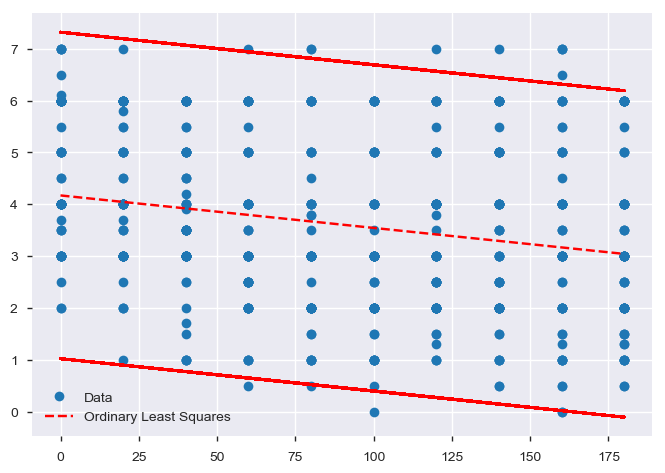

In [24]:
prstd, iv_l, iv_u = wls_prediction_std(results1)

x1 = data["phase_diff"]
y=data["magnitude"]

plt.plot(x1, y, 'o', label="Data")
plt.plot(x1, results1.fittedvalues, 'r--')
plt.plot(x1, iv_u, 'r--', label="Ordinary Least Squares")
plt.plot(x1, iv_l, 'r--')
plt.legend(loc="best");
plt.show()

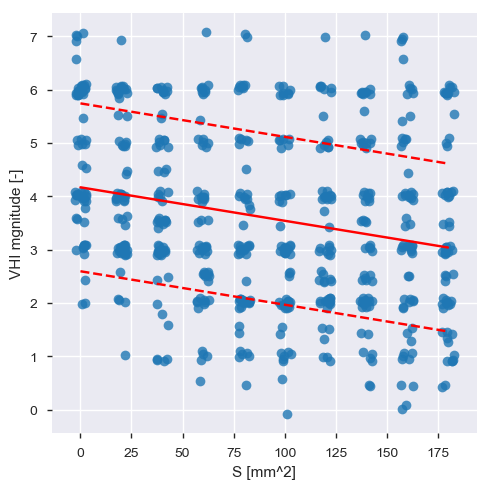

In [25]:
g = sns.lmplot(x = "phase_diff", y = "magnitude", data = data, fit_reg = False, x_jitter = 3 , y_jitter = 0.1)
x = data["phase_diff"]
plt.plot(x, results1.fittedvalues, 'r-')
cv = 1.5743766210084735
plt.plot(x, results1.fittedvalues+cv, 'r--')
plt.plot(x, results1.fittedvalues-cv, 'r--')
plt.xlabel("S [mm^2]")
plt.ylabel("VHI mgnitude [-]")
plt.show()

In [26]:
#二次式
results2 = smf.ols("magnitude ~ phase_diff + I(phase_diff**2)", data = data).fit()
display(results2.summary())

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              magnitude   R-squared:                       0.070
Model:                            OLS   Adj. R-squared:                  0.067
Method:                 Least Squares   F-statistic:                     22.59
Date:                Mon, 21 Jan 2019   Prob (F-statistic):           3.47e-10
Time:                        16:03:10   Log-Likelihood:                -1125.3
No. Observations:                 600   AIC:                             2257.
Df Residuals:                     597   BIC:                             2270.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
======================================================================================
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Intercept              4.5712      0.161     28.457      0.000       4.256       4.887
phase_diff            -0.0213      0.004     -5.125      0.000      -0.029      -0.013
I(phase_diff ** 2)  8.349e-05   2.22e-05      3.756      0.000    3.98e-05       0.000
==============================================================================
Omnibus:                       44.814   Durbin-Watson:                   0.704
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               20.845
Skew:                           0.257   Prob(JB):                     2.98e-05
Kurtosis:                       2.245   Cond. No.                     3.90e+04
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 3.9e+04. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [27]:
from patsy import dmatrices, dmatrix
dmatrices("magnitude ~ phase_diff + I(phase_diff**2)", data)

(DesignMatrix with shape (600, 1)
   magnitude
         6.0
         5.0
         3.5
         1.0
         2.0
         3.0
         5.0
         2.5
         3.0
         2.0
         5.5
         5.0
         4.5
         4.0
         3.0
         2.0
         2.0
         2.5
         4.0
         1.0
         6.0
         6.0
         4.5
         2.5
         2.0
         1.0
         3.5
         5.0
         4.0
         4.0
   [570 rows omitted]
   Terms:
     'magnitude' (column 0)
   (to view full data, use np.asarray(this_obj)),
 DesignMatrix with shape (600, 3)
   Intercept  phase_diff  I(phase_diff ** 2)
           1           0                   0
           1          20                 400
           1          40                1600
           1          60                3600
           1          80                6400
           1         100               10000
           1         120               14400
           1         140               19600
           1  

In [28]:
data.loc[:,"fittedvalues"] = results2.fittedvalues
data

,subject,phase_diff,magnitude,phase_diff_radian,fittedvalues
0,横山君,0,6.0,0.000000,4.571242
1,横山君,20,5.0,0.349066,4.178667
2,横山君,40,3.5,0.698132,3.852884
3,横山君,60,1.0,1.047198,3.593894
4,横山君,80,2.0,1.396263,3.401697
5,横山君,100,3.0,1.745329,3.276293
6,横山君,120,5.0,2.094395,3.217682
7,横山君,140,2.5,2.443461,3.225864
8,横山君,160,3.0,2.792527,3.300838
9,横山君,180,2.0,3.141593,3.442606


In [29]:
data.loc[data["phase_diff"] == 100,"fittedvalues"].unique()

array([3.27629293])

In [30]:
x = data.loc[:9,"phase_diff"]
x

0      0
1     20
2     40
3     60
4     80
5    100
6    120
7    140
8    160
9    180
Name: phase_diff, dtype: int64

In [31]:
yy = data.loc[:9,"fittedvalues"]
yy

0    4.571242
1    4.178667
2    3.852884
3    3.593894
4    3.401697
5    3.276293
6    3.217682
7    3.225864
8    3.300838
9    3.442606
Name: fittedvalues, dtype: float64

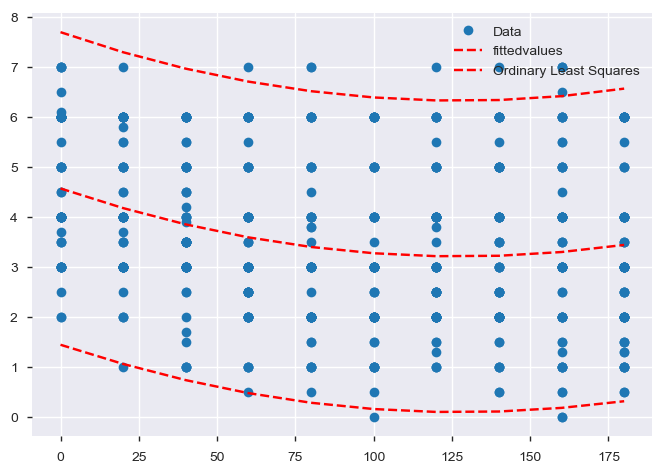

In [32]:
prstd, iv_l, iv_u = wls_prediction_std(results2)

x1 = data["phase_diff"]
y = data["magnitude"]

plt.plot(x1, y, 'o', label="Data")
plt.plot(x, yy, 'r--')

plt.plot(x, iv_u[:10], 'r--', label="Ordinary Least Squares")
plt.plot(x, iv_l[:10], 'r--')

plt.legend(loc="best")
plt.savefig('figure/figure.png')
plt.show()



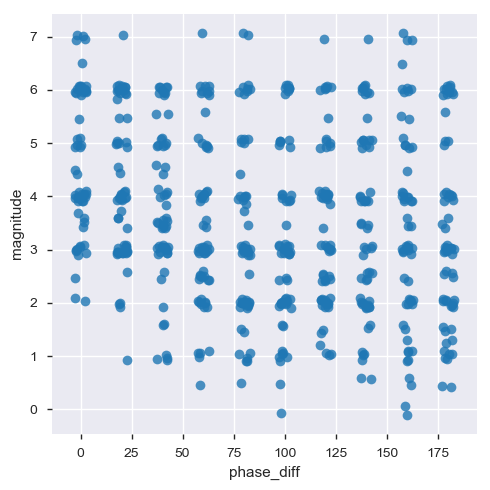

In [33]:
g = sns.lmplot(x = "phase_diff", y = "magnitude", data = data, fit_reg = False, x_jitter = 3 , y_jitter = 0.1)
g

# CV値の計算

これからOLS以外のモデリングを試していくが，結果の比較をすることが必要である．AICなどの情報量基準でも良いが，理解のしやすさからCV値で比較をする．

splitの仕方が3つあるように思える  
1.無作為  
2.各ユーザーごとでsplit(trainのデータに各ユーザのデータが同じ数だけ入る)  内挿  
3.ユーザでsplit(trainにデータのあるユーザはtestのなかにはない）  被験者に対して外挿  
4.phase_diffの値でsplit(trainにあるphase_diffはtestにない) 位相差に対して外挿  

In [35]:
#方法1
kf_random = KFold(n_splits = 5,shuffle = True)
kf_random.get_n_splits(data)
print(kf_random)
for train_index, test_index in kf_random.split(data):
    print("TRAIN:", train_index, "TEST:", test_index)
    print("train len", len(train_index), "test len", len(test_index))


KFold(n_splits=5, random_state=None, shuffle=True)
TRAIN: [  0   1   2   4   5   6   7   8   9  12  13  14  15  16  18  19  20  21
  22  23  24  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41
  43  44  46  47  48  49  51  52  53  54  55  56  57  58  59  60  62  66
  67  68  70  71  73  74  75  76  77  78  79  80  81  82  83  84  85  86
  88  89  90  91  93  94  97  98  99 101 102 103 104 106 107 108 109 113
 114 116 117 118 120 121 122 123 124 125 126 127 128 129 130 131 132 133
 134 135 136 137 138 141 142 143 146 147 148 149 150 152 155 156 157 158
 159 160 161 162 163 165 166 168 169 170 171 173 174 175 176 178 179 181
 182 183 184 185 186 187 188 189 190 191 192 193 194 195 198 199 200 201
 202 203 204 205 206 207 208 209 211 212 213 214 216 217 221 222 223 224
 225 226 227 228 229 230 231 232 235 236 237 238 239 240 241 243 244 245
 246 248 252 254 258 259 260 262 263 264 265 266 268 270 271 272 273 274
 275 277 278 279 280 281 282 283 284 285 287 288 290 291 293 294 2

In [36]:
#方法2
kf_st = StratifiedKFold(n_splits=5)
for train_index, test_index in kf_st.split(data, data["subject"]):
    print("TRAIN:", train_index, "TEST:", test_index)
    print("train len", len(train_index), "test len", len(test_index))
    

TRAIN: [ 12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29
  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47
  48  49  50  51  52  53  54  55  56  57  58  59  72  73  74  75  76  77
  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115 116 117 118 119 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207 208 209
 210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225 226 227
 228 229 230 231 232 233 234 235 236 237 238 239 252 253 254 255 256 257
 258 259 260 261 262 263 264 265 266 267 268 269 270 271 272 273 274 275
 276 277 278 279 280 281 282 283 284 285 286 287 288 289 290 291 292 293
 294 295 296 297 298 299 312 313 314 315 316

In [37]:
#方法3
kf_group = GroupKFold(n_splits = 5)
for train_index, test_index in kf_group.split(data, data["magnitude"], data["subject"]):
    print("TRAIN:", train_index, "TEST:", test_index)
    print("train len", len(train_index), "test len", len(test_index))

TRAIN: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 240 241 242 243 244 245 246 247 248 249 250 251 252 253 254 255 256 257
 258 259 260 261 262 263 264 265 266 267 268 269 270 271 272 273 274 275
 276 277 278 279 280 281 282 283 284 285 286 287 288 289 290 291 292 293
 294 295 296 297 298 299 300 301 302 303 304

In [38]:
#方法4
kf_phase = GroupKFold(n_splits = 5)
for train_index, test_index in kf_phase.split(data, data["magnitude"], data["phase_diff"]):
    print("TRAIN:", train_index, "TEST:", test_index)
    print("train len", len(train_index), "test len", len(test_index))

TRAIN: [  0   1   2   3   5   6   7   8  10  11  12  13  15  16  17  18  20  21
  22  23  25  26  27  28  30  31  32  33  35  36  37  38  40  41  42  43
  45  46  47  48  50  51  52  53  55  56  57  58  60  61  62  63  65  66
  67  68  70  71  72  73  75  76  77  78  80  81  82  83  85  86  87  88
  90  91  92  93  95  96  97  98 100 101 102 103 105 106 107 108 110 111
 112 113 115 116 117 118 120 121 122 123 125 126 127 128 130 131 132 133
 135 136 137 138 140 141 142 143 145 146 147 148 150 151 152 153 155 156
 157 158 160 161 162 163 165 166 167 168 170 171 172 173 175 176 177 178
 180 181 182 183 185 186 187 188 190 191 192 193 195 196 197 198 200 201
 202 203 205 206 207 208 210 211 212 213 215 216 217 218 220 221 222 223
 225 226 227 228 230 231 232 233 235 236 237 238 240 241 242 243 245 246
 247 248 250 251 252 253 255 256 257 258 260 261 262 263 265 266 267 268
 270 271 272 273 275 276 277 278 280 281 282 283 285 286 287 288 290 291
 292 293 295 296 297 298 300 301 302 303 305

## OLSによる推定

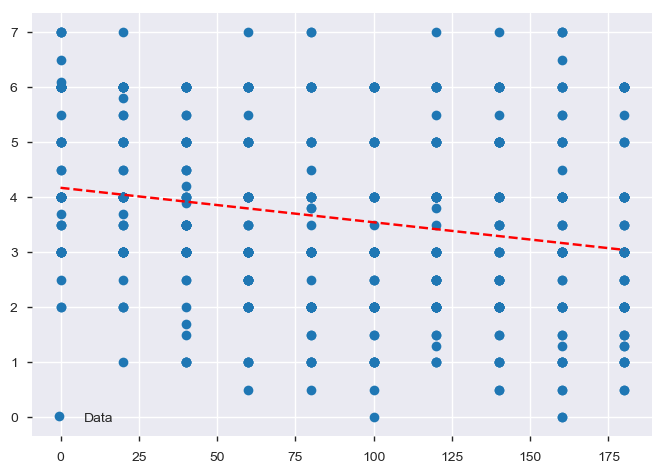

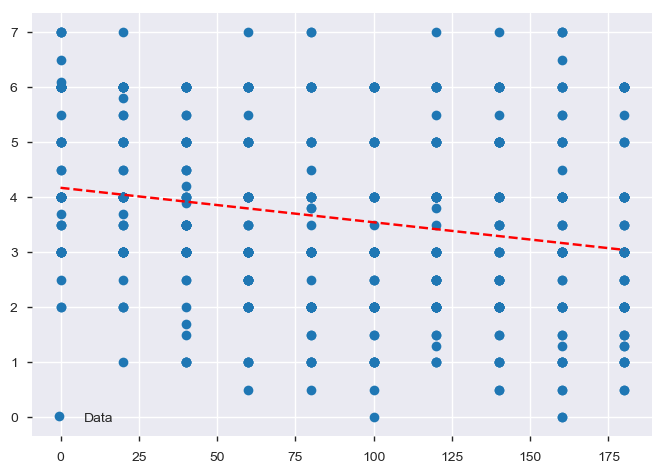

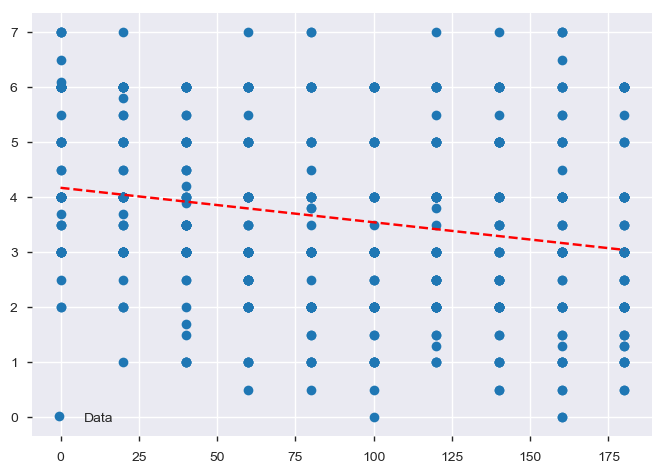

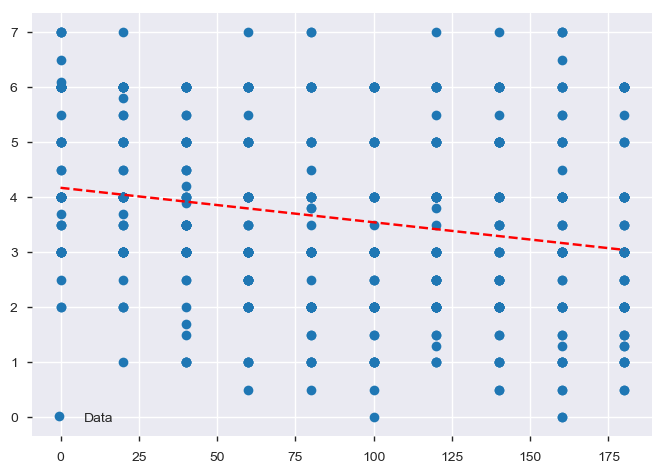

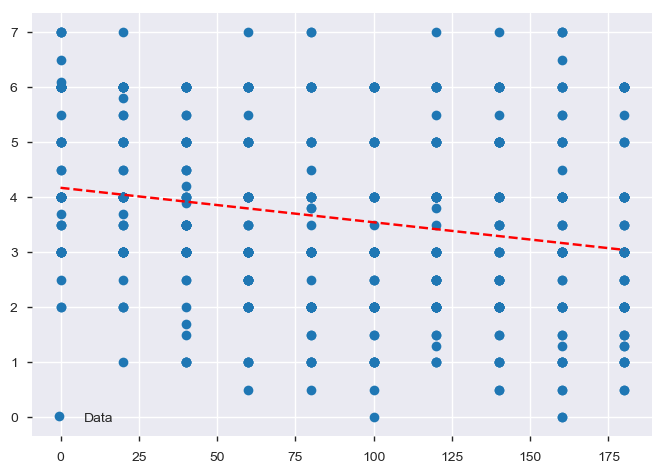

In [39]:
#indexで5Foldに分ける
cv_rand_results = []
cv_rand_preds = []
cv_rand_scores_rmse = []
cv_rand_scores_mae = []

cv_st_results = []
cv_st_preds = []
cv_st_scores_rmse = []
cv_st_scores_mae = []

cv_group_results = []
cv_group_preds = []
cv_group_scores_rmse = []
cv_group_scores_mae = []

cv_phase_results = []
cv_phase_preds = []
cv_phase_scores_rmse = []
cv_phase_scores_mae = []

i = 0
x = data.loc[:9,"phase_diff"]

#一次式で回帰

for train_index, test_index in kf_random.split(data):
    i += 1
    data_train = data.loc[train_index,:]
    data_test = data.loc[test_index,:]
    
    results = smf.ols("magnitude ~ phase_diff", data = data).fit()
    cv_rand_results.append(results)
    
    y_pred = results.predict(data_test)
    cv_rand_preds.append(y_pred)
    
    y_test = data_test["magnitude"].values
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    cv_rand_scores_rmse.append(rmse)
    mae = mean_absolute_error(y_test, y_pred)
    cv_rand_scores_mae.append(mae)
    
    data_train.loc[:,"fittedvalues"] = results.fittedvalues
    x = pd.DataFrame({"phase_diff":[0,20,40,60,80,100,120,140,160,180]})
    y = results.predict(x)
    
    xx = data["phase_diff"]
    yy = data["magnitude"]
    
    plt.plot(xx, yy, 'o', label="Data")
    plt.plot(x, y, 'r--')
    
    plt.legend(loc="best")
    plt.savefig('figure/figure' + str(i) + '.png')
    plt.show()
    
for train_index, test_index in kf_st.split(data, data["subject"]):
    data_train = data.loc[train_index,:]
    data_test = data.loc[test_index,:]
    
    results = smf.ols("magnitude ~ phase_diff", data = data).fit()
    cv_st_results.append(results)
    
    y_pred = results.predict(data_test)
    cv_st_preds.append(y_pred)
    
    y_test = data_test["magnitude"].values
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    cv_st_scores_rmse.append(rmse)
    mae = mean_absolute_error(y_test, y_pred)
    cv_st_scores_mae.append(mae)
    
for train_index, test_index in kf_group.split(data, data["magnitude"], data["subject"]):
    data_train = data.loc[train_index,:]
    data_test = data.loc[test_index,:]
    
    results = smf.ols("magnitude ~ phase_diff", data = data).fit()
    cv_group_results.append(results)
    
    y_pred = results.predict(data_test)
    cv_group_preds.append(y_pred)
    
    y_test = data_test["magnitude"].values
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    cv_group_scores_rmse.append(rmse)
    mae = mean_absolute_error(y_test, y_pred)
    cv_group_scores_mae.append(mae)
    
        
for train_index, test_index in kf_phase.split(data, data["magnitude"], data["phase_diff"]):
    data_train = data.loc[train_index,:]
    data_test = data.loc[test_index,:]
    
    results = smf.ols("magnitude ~ phase_diff", data = data).fit()
    cv_phase_results.append(results)
    
    y_pred = results.predict(data_test)
    cv_phase_preds.append(y_pred)
    
    y_test = data_test["magnitude"].values
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    cv_phase_scores_rmse.append(rmse)
    mae = mean_absolute_error(y_test, y_pred)
    cv_phase_scores_mae.append(mae)

,magnitude,phase_diff_radian,fittedvalues,phase_diff
phase_diff,,,,
0,4.537500,0.000000,4.571242,0
20,4.260417,0.349066,4.178667,20
40,3.735417,0.698132,3.852884,40
60,3.427083,1.047198,3.593894,60
80,3.366667,1.396263,3.401697,80
100,3.239583,1.745329,3.276293,100
120,3.272917,2.094395,3.217682,120
140,3.447917,2.443461,3.225864,140
160,3.537500,2.792527,3.300838,160


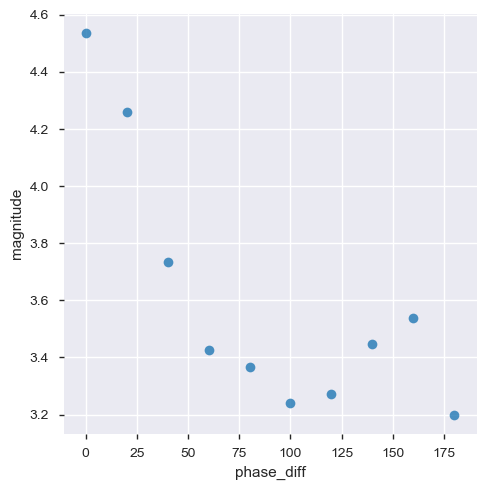

,magnitude,phase_diff_radian,fittedvalues,phase_diff
phase_diff,,,,
0,4.535417,0.000000,4.571242,0
20,3.972917,0.349066,4.178667,20
40,3.587500,0.698132,3.852884,40
60,3.302083,1.047198,3.593894,60
80,3.041667,1.396263,3.401697,80
100,2.833333,1.745329,3.276293,100
120,3.120833,2.094395,3.217682,120
140,3.260417,2.443461,3.225864,140
160,3.172917,2.792527,3.300838,160


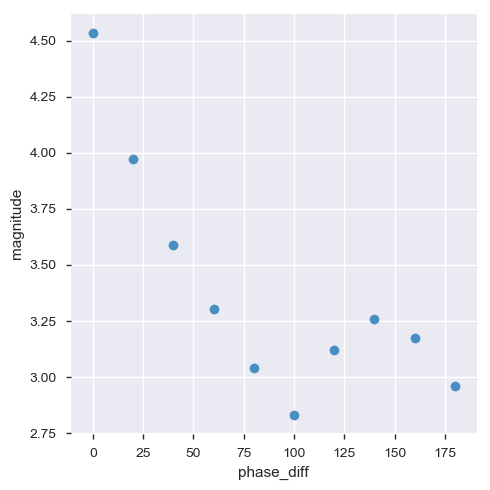

,magnitude,phase_diff_radian,fittedvalues,phase_diff
phase_diff,,,,
0,4.908333,0.000000,4.571242,0
20,4.495833,0.349066,4.178667,20
40,4.085417,0.698132,3.852884,40
60,3.854167,1.047198,3.593894,60
80,3.720833,1.396263,3.401697,80
100,3.520833,1.745329,3.276293,100
120,3.777083,2.094395,3.217682,120
140,3.895833,2.443461,3.225864,140
160,3.895833,2.792527,3.300838,160


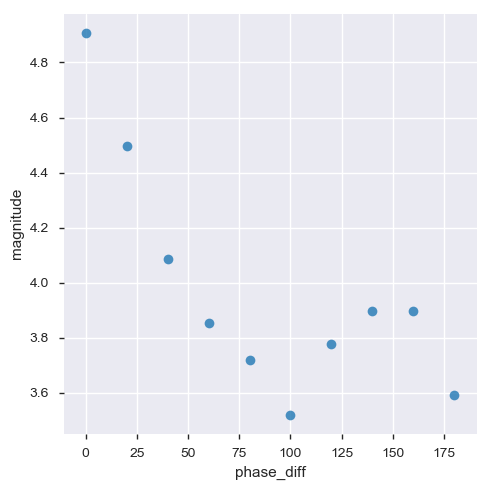

,magnitude,phase_diff_radian,fittedvalues,phase_diff
phase_diff,,,,
0,4.652083,0.000000,4.571242,0
20,4.020833,0.349066,4.178667,20
40,3.891667,0.698132,3.852884,40
60,3.593750,1.047198,3.593894,60
80,3.168750,1.396263,3.401697,80
100,3.197917,1.745329,3.276293,100
120,3.481250,2.094395,3.217682,120
140,3.260417,2.443461,3.225864,140
160,3.068750,2.792527,3.300838,160


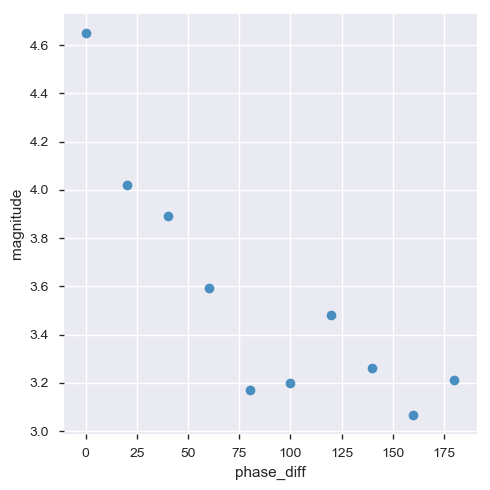

,magnitude,phase_diff_radian,fittedvalues,phase_diff
phase_diff,,,,
0,4.683333,0.000000,4.571242,0
20,4.125000,0.349066,4.178667,20
40,3.766667,0.698132,3.852884,40
60,3.364583,1.047198,3.593894,60
80,3.168750,1.396263,3.401697,80
100,3.000000,1.745329,3.276293,100
120,3.231250,2.094395,3.217682,120
140,3.343750,2.443461,3.225864,140
160,3.308333,2.792527,3.300838,160


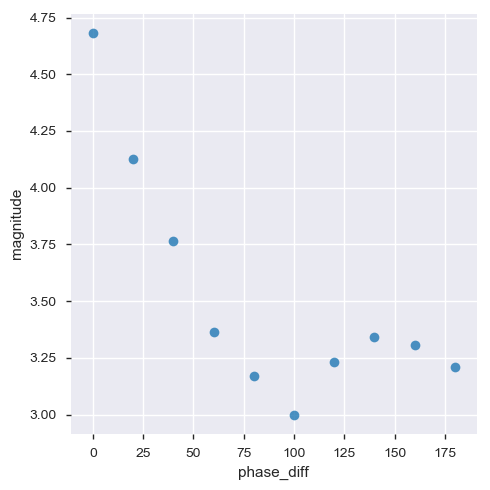

In [40]:
#indexで5Foldに分ける
cv_rand_results = []
cv_rand_preds = []
cv_rand_scores_rmse = []
cv_rand_scores_mae = []

cv_st_results = []
cv_st_preds = []
cv_st_scores_rmse = []
cv_st_scores_mae = []

cv_group_results = []
cv_group_preds = []
cv_group_scores_rmse = []
cv_group_scores_mae = []

cv_phase_results = []
cv_phase_preds = []
cv_phase_scores_rmse = []
cv_phase_scores_mae = []

i = 0
x = data.loc[:9,"phase_diff"]

for train_index, test_index in kf_group.split(data, data["magnitude"], data["subject"]):
    data_train = data.loc[train_index,:]
    data_test = data.loc[test_index,:]
    
    results = smf.ols("magnitude ~ phase_diff", data = data).fit()
    cv_group_results.append(results)
    
    y_pred = results.predict(data_test)
    cv_group_preds.append(y_pred)
    
    y_test = data_test["magnitude"].values
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    cv_group_scores_rmse.append(rmse)
    mae = mean_absolute_error(y_test, y_pred)
    cv_group_scores_mae.append(mae)
    
    #phase_diffに沿った平均
    phase_diff_mean = data_train.groupby(["phase_diff"]).mean()
    phase_diff_mean.loc[:,"phase_diff"] = phase_diff_mean.index
    display(phase_diff_mean)
    sns.lmplot(x = "phase_diff", y = "magnitude", data = phase_diff_mean, fit_reg = None)
    plt.show()
    #data.groupby(["subject", "phase_diff"]).var()

# OLS 一次式

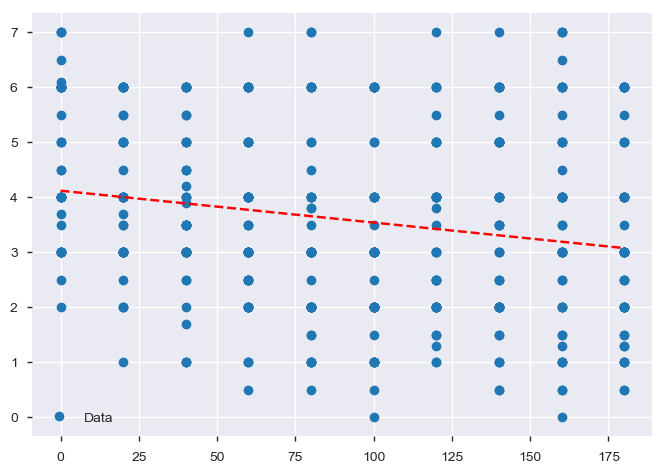

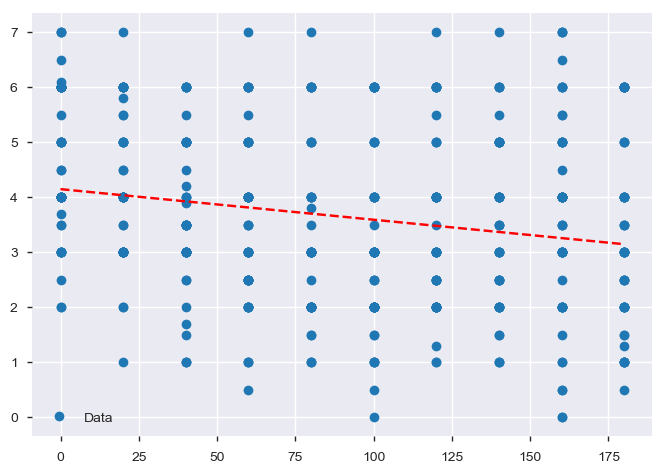

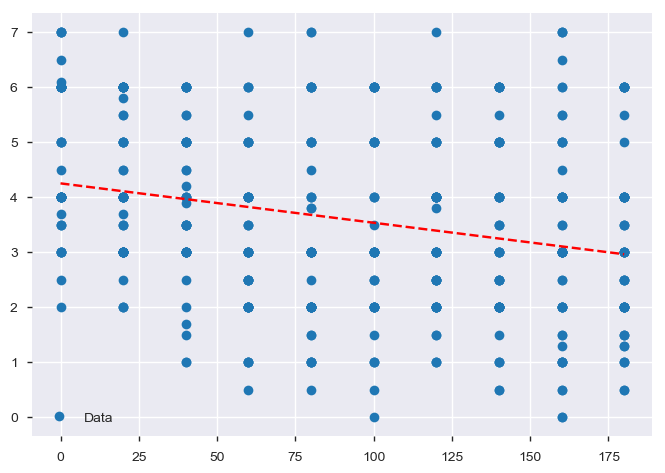

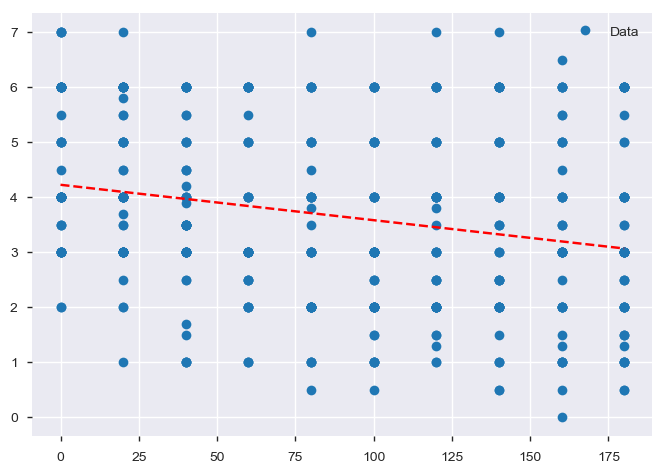

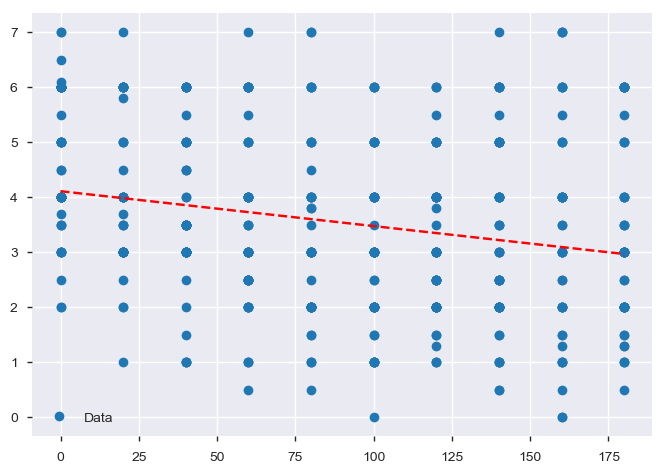

In [41]:
#indexで5Foldに分ける
cv_rand_results = []
cv_rand_preds = []
cv_rand_scores_rmse = []
cv_rand_scores_mae1 = []

train_scores1 = []

cv_st_results = []
cv_st_preds = []
cv_st_scores_rmse = []
cv_st_scores_mae = []

cv_group_results = []
cv_group_preds = []
cv_group_scores_rmse = []
cv_group_scores_mae = []

cv_phase_results = []
cv_phase_preds = []
cv_phase_scores_rmse = []
cv_phase_scores_mae = []

i = 0
x = data.loc[:9,"phase_diff"]

formula = "magnitude ~ phase_diff"

#1次式で回帰

for train_index, test_index in kf_random.split(data):
    data_train = data.loc[train_index,:]
    data_test = data.loc[test_index,:]
    
    results = smf.ols(formula , data = data_train).fit()
    cv_rand_results.append(results)
    
    train_scores1.append(np.abs(results.resid).mean())
    
    y_pred = results.predict(data_test)
    cv_rand_preds.append(y_pred)
    
    y_test = data_test["magnitude"].values
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    cv_rand_scores_rmse.append(rmse)
    mae = mean_absolute_error(y_test, y_pred)
    cv_rand_scores_mae1.append(mae)
    
    data_train.loc[:,"fittedvalues"] = results.fittedvalues
    x = pd.DataFrame({"phase_diff":[0,20,40,60,80,100,120,140,160,180]})
    y = results.predict(x)
    
    xx = data_train["phase_diff"]
    yy = data_train["magnitude"]
    
    plt.plot(xx, yy, 'o', label="Data")
    plt.plot(x, y, 'r--')
    
    plt.legend(loc="best")
    plt.savefig('figure/figure' + str(i) + '.png')
    plt.show()
    


In [42]:
cv_rand_scores_mae1

[1.1841954946085833,
 1.421944892406852,
 1.3333795501322148,
 1.3751449890461032,
 1.386131744610051]

In [43]:
pd.DataFrame(cv_rand_scores_mae1).mean()

0    1.340159
dtype: float64

In [44]:
train_scores1

[1.3698426818154261,
 1.3184524383203433,
 1.3366192839861657,
 1.33075441068914,
 1.312418394275917]

In [45]:
pd.DataFrame(train_scores1).mean()

0    1.333617
dtype: float64

# OLS二次式で回帰

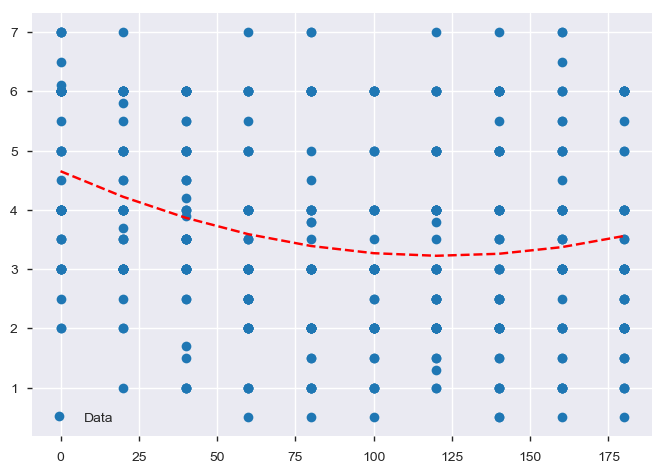

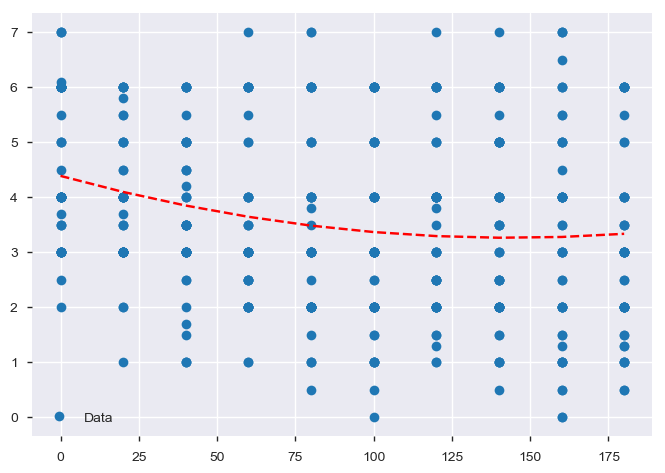

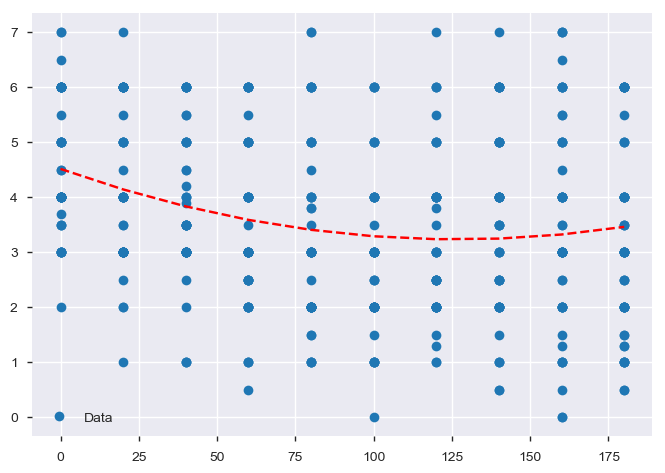

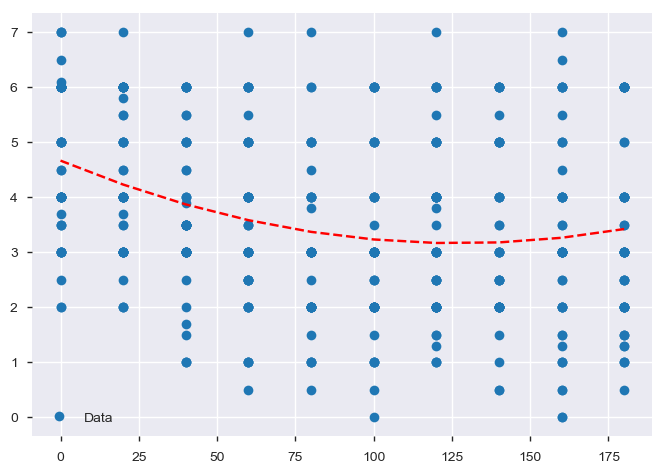

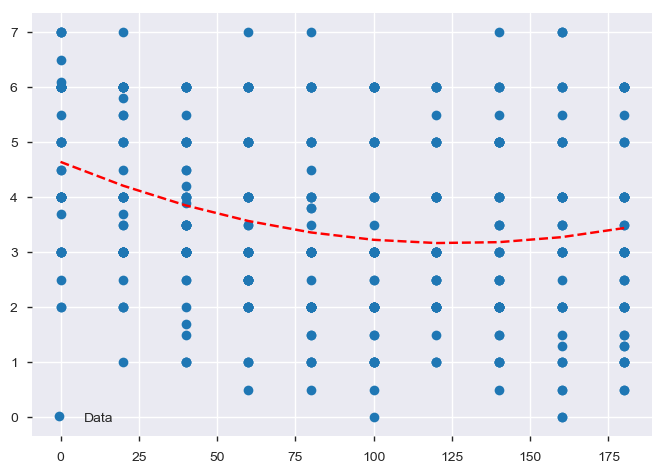

In [46]:
#indexで5Foldに分ける
cv_rand_results = []
cv_rand_preds = []
cv_rand_scores_rmse = []
cv_rand_scores_mae2 = []

train_scores2 = []

cv_st_results = []
cv_st_preds = []
cv_st_scores_rmse = []
cv_st_scores_mae = []

cv_group_results = []
cv_group_preds = []
cv_group_scores_rmse = []
cv_group_scores_mae = []

cv_phase_results = []
cv_phase_preds = []
cv_phase_scores_rmse = []
cv_phase_scores_mae = []

i = 0
x = data.loc[:9,"phase_diff"]

formula = "magnitude ~ phase_diff + I(phase_diff**2)"

#2次式で回帰

for train_index, test_index in kf_random.split(data):
    data_train = data.loc[train_index,:]
    data_test = data.loc[test_index,:]
    
    results = smf.ols(formula , data = data_train).fit()
    cv_rand_results.append(results)
    
    train_scores2.append(np.abs(results.resid).mean())

    
    y_pred = results.predict(data_test)
    cv_rand_preds.append(y_pred)
    
    y_test = data_test["magnitude"].values
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    cv_rand_scores_rmse.append(rmse)
    mae = mean_absolute_error(y_test, y_pred)
    cv_rand_scores_mae2.append(mae)
    
    data_train.loc[:,"fittedvalues"] = results.fittedvalues
    x = pd.DataFrame({"phase_diff":[0,20,40,60,80,100,120,140,160,180]})
    y = results.predict(x)
    
    xx = data_train["phase_diff"]
    yy = data_train["magnitude"]
    
    plt.plot(xx, yy, 'o', label="Data")
    plt.plot(x, y, 'r--')
    
    plt.legend(loc="best")
    plt.savefig('figure/figure' + str(i) + '.png')
    plt.show()
    

In [47]:
print("cv_randでの絶対平均誤差")
print(cv_rand_scores_mae2)


cv_randでの絶対平均誤差
[1.3235302405209213, 1.2591483977384583, 1.4169854261493355, 1.4624355299792526, 1.2053164437787414]


In [48]:
print("cv_randscore_maeの平均")
print(np.array(cv_rand_scores_mae2).mean())


cv_randscore_maeの平均
1.3334832076333418


In [49]:
print(train_scores2)
pd.DataFrame(train_scores2).mean()

[1.3304772295988412, 1.343640242302479, 1.3017095035104662, 1.2893719046175847, 1.352341995034623]


0    1.323508
dtype: float64

# OLS三次式で回帰

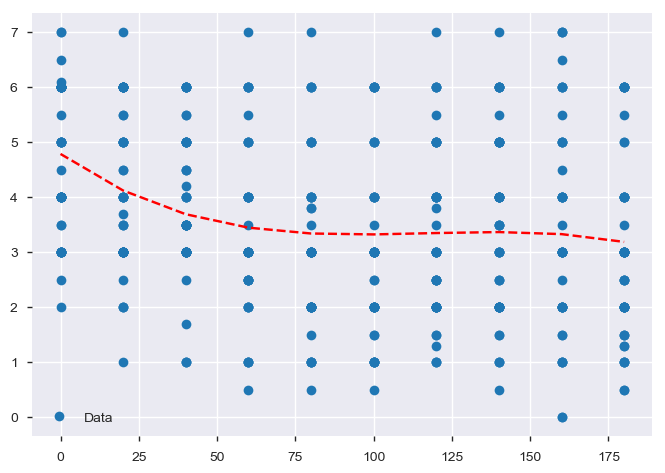

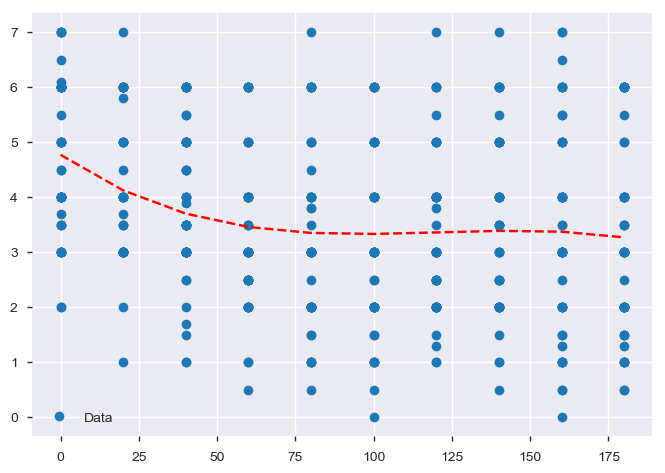

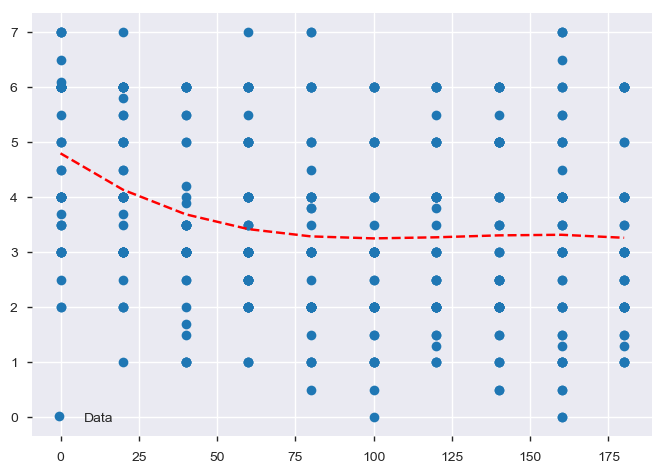

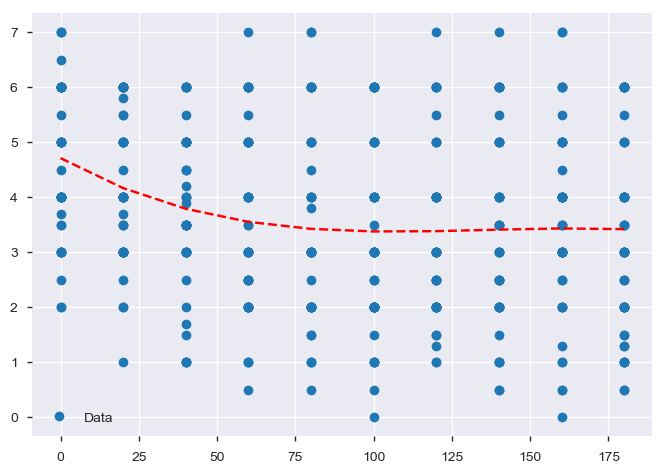

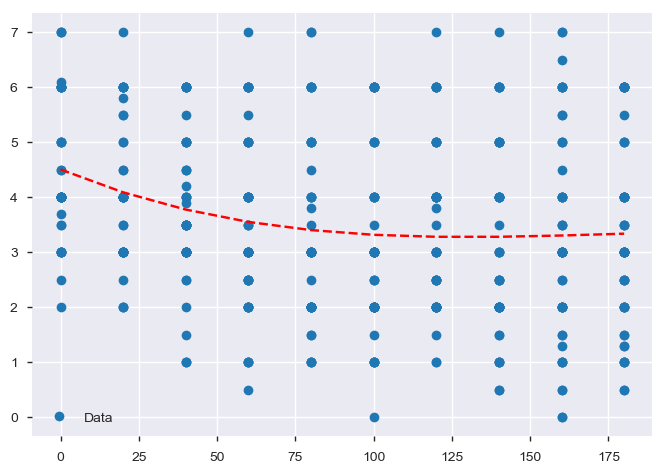

In [50]:
#indexで5Foldに分ける
cv_rand_results = []
cv_rand_preds = []
cv_rand_scores_rmse = []
cv_rand_scores_mae3 = []

train_scores3 = []

cv_st_results = []
cv_st_preds = []
cv_st_scores_rmse = []
cv_st_scores_mae = []

cv_group_results = []
cv_group_preds = []
cv_group_scores_rmse = []
cv_group_scores_mae = []

cv_phase_results = []
cv_phase_preds = []
cv_phase_scores_rmse = []
cv_phase_scores_mae = []

formula = "magnitude ~ phase_diff + I(phase_diff**2) + I(phase_diff**3)"



for train_index, test_index in kf_random.split(data):
    data_train = data.loc[train_index,:]
    data_test = data.loc[test_index,:]
    
    results = smf.ols(formula , data = data_train).fit()
    cv_rand_results.append(results)
    
    train_scores3.append(np.abs(results.resid).mean())

    
    y_pred = results.predict(data_test)
    cv_rand_preds.append(y_pred)
    
    y_test = data_test["magnitude"].values
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    cv_rand_scores_rmse.append(rmse)
    mae = mean_absolute_error(y_test, y_pred)
    cv_rand_scores_mae3.append(mae)
    
    data_train.loc[:,"fittedvalues"] = results.fittedvalues
    x = pd.DataFrame({"phase_diff":[0,20,40,60,80,100,120,140,160,180]})
    y = results.predict(x)
    
    xx = data_train["phase_diff"]
    yy = data_train["magnitude"]
    
    plt.plot(xx, yy, 'o', label="Data")
    plt.plot(x, y, 'r--')
    
    plt.legend(loc="best")
    plt.savefig('figure/figure' + str(i) + '.png')
    plt.show()
    

In [51]:
cv_rand_scores_mae3

[1.3753762492459984,
 1.4377573794908853,
 1.2426040548309132,
 1.2752317172746421,
 1.328288700807409]

In [52]:
print("cv_randscore_maeの平均")
print(np.array(cv_rand_scores_mae3).mean())


cv_randscore_maeの平均
1.3318516203299695


In [53]:
print(train_scores2)
pd.DataFrame(train_scores3).mean()

[1.3304772295988412, 1.343640242302479, 1.3017095035104662, 1.2893719046175847, 1.352341995034623]


0    1.318998
dtype: float64

# 2システムモデル  

```math
f( \theta )
```

In [54]:

X_train, X_test, _,_ = train_test_split(data, data["magnitude"], test_size=0.33, random_state=42)

In [55]:
data = X_train
print(data.shape)
data.head()

(402, 5)


,subject,phase_diff,magnitude,phase_diff_radian,fittedvalues
509,渡邉君,180,4.0,3.141593,3.442606
149,向畑君,180,1.5,3.141593,3.442606
124,向畑君,80,1.0,1.396263,3.401697
428,池田君,160,0.0,2.792527,3.300838
465,池田君,100,1.5,1.745329,3.276293


In [56]:
left_data = data.loc[data["phase_diff"] < 90,:]
print(left_data.shape)


(204, 5)


In [57]:
right_data = data.loc[data["phase_diff"] > 90,:]
print(right_data.shape)

(198, 5)


C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



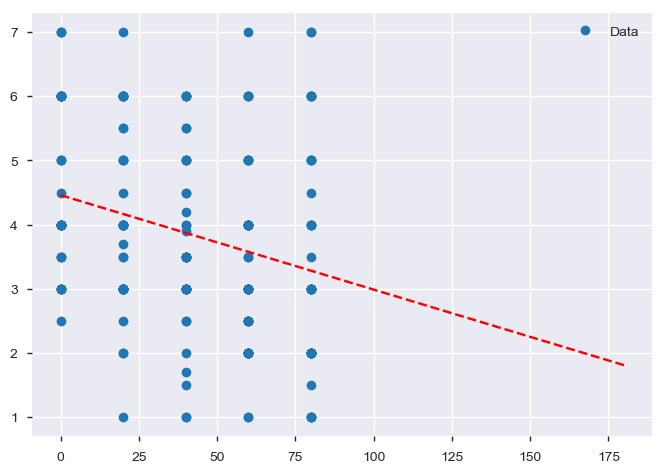

In [58]:
left_results = smf.ols("magnitude ~ phase_diff", data = left_data).fit()
left_data.loc[:,"fittedvalues"] = left_results.fittedvalues
x = pd.DataFrame({"phase_diff":[0,20,40,60,80,100,120,140,160,180]})
y = left_results.predict(x)
xx = left_data["phase_diff"]
yy = left_data["magnitude"]
    
plt.plot(xx, yy, 'o', label="Data")
plt.plot(x, y, 'r--')
    
plt.legend(loc="best")
#plt.savefig('figure/figure' + str(i) + '.png')
plt.show()

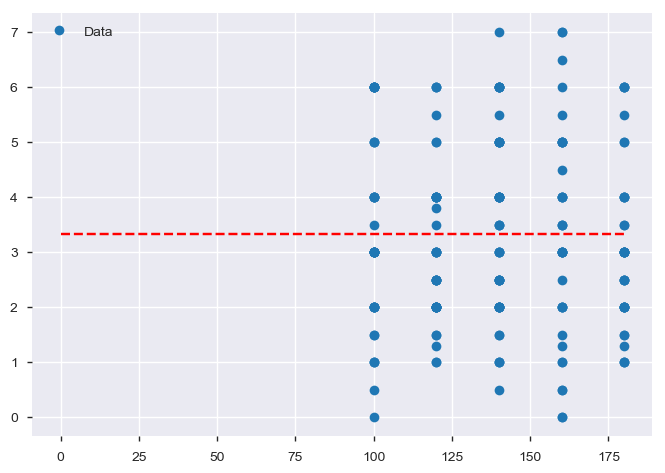

In [59]:

X = [1]*right_data.shape[0]
Y = right_data["magnitude"]
right_results = sm.OLS(Y,X).fit()
right_data.loc[:,"fittedvalues"] = right_results.fittedvalues
x = pd.DataFrame({"phase_diff":[0,20,40,60,80,100,120,140,160,180]})
y = [3.324]*x.shape[0]
xx = right_data["phase_diff"]
yy = right_data["magnitude"]
    
plt.plot(xx, yy, 'o', label="Data")
plt.plot(x, y, 'r--')
    
plt.legend(loc="best")
#plt.savefig('figure/figure' + str(i) + '.png')
plt.show()

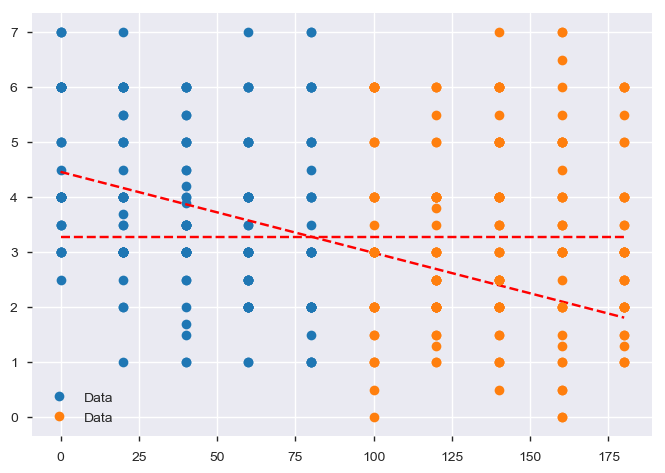

In [60]:
left_results = smf.ols("magnitude ~ phase_diff", data = left_data).fit()
left_data.loc[:,"fittedvalues"] = left_results.fittedvalues
left_x = pd.DataFrame({"phase_diff":[0,20,40,60,80,100,120,140,160,180]})
left_y = left_results.predict(x)
left_xx = left_data["phase_diff"].reset_index(drop=True)
left_yy = left_data["magnitude"].reset_index(drop=True)


X = [1]*right_data.shape[0]
Y = right_data["magnitude"]
right_results = sm.OLS(Y,X).fit()
right_data.loc[:,"fittedvalues"] = right_results.fittedvalues
right_x = pd.DataFrame({"phase_diff":[0,20,40,60,80,100,120,140,160,180]})
right_y = [right_results.params[0]]*x.shape[0]
right_xx = right_data["phase_diff"].reset_index(drop=True)
right_yy = right_data["magnitude"].reset_index(drop=True)
    
plt.plot(left_xx, left_yy, 'o', label="Data")
plt.plot(left_x, left_y, 'r--')

plt.plot(right_xx, right_yy, 'o', label="Data")
plt.plot(right_x, right_y, 'r--')
    
plt.legend(loc="best")
#plt.savefig('figure/figure' + str(i) + '.png')
plt.show()

In [61]:
upper_y = (left_y > right_y)*left_y + (left_y < right_y)*right_y
upper_x = left_x

In [62]:
upper_df = pd.DataFrame(upper_x)
upper_df["y"] = upper_y
upper_df.columns = ["x","pred_y"]

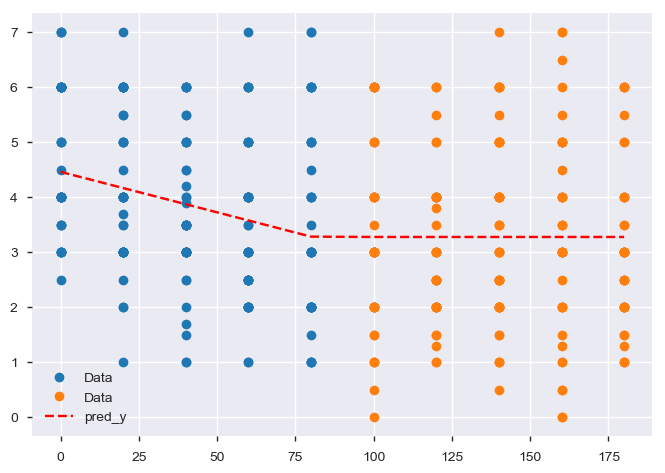

In [63]:
plt.plot(left_xx, left_yy, 'o', label="Data")

plt.plot(right_xx, right_yy, 'o', label="Data")

plt.plot(upper_df["x"], upper_df["pred_y"], 'r--')
    

plt.legend(loc="best")
#plt.savefig('figure/figure' + str(i) + '.png')
plt.show()

In [64]:
data = pd.merge(data,upper_df,left_on="phase_diff",right_on="x")
data

,subject,phase_diff,magnitude,phase_diff_radian,fittedvalues,x,pred_y
0,渡邉君,180,4.0,3.141593,3.442606,180,3.276263
1,向畑君,180,1.5,3.141593,3.442606,180,3.276263
2,上島君,180,1.5,3.141593,3.442606,180,3.276263
3,横山君,180,1.0,3.141593,3.442606,180,3.276263
4,横山君,180,2.0,3.141593,3.442606,180,3.276263
5,梅津君,180,4.0,3.141593,3.442606,180,3.276263
6,仙石君,180,6.0,3.141593,3.442606,180,3.276263
7,渡邉君,180,2.0,3.141593,3.442606,180,3.276263
8,上島君,180,3.5,3.141593,3.442606,180,3.276263
9,梅津君,180,4.0,3.141593,3.442606,180,3.276263


In [65]:
data["res"] = data["magnitude"]-data["pred_y"]
data["abs_res"] = np.abs(data["magnitude"]-data["pred_y"])

data.head()

,subject,phase_diff,magnitude,phase_diff_radian,fittedvalues,x,pred_y,res,abs_res
0,渡邉君,180,4.0,3.141593,3.442606,180,3.276263,0.723737,0.723737
1,向畑君,180,1.5,3.141593,3.442606,180,3.276263,-1.776263,1.776263
2,上島君,180,1.5,3.141593,3.442606,180,3.276263,-1.776263,1.776263
3,横山君,180,1.0,3.141593,3.442606,180,3.276263,-2.276263,2.276263
4,横山君,180,2.0,3.141593,3.442606,180,3.276263,-1.276263,1.276263


In [66]:
train_mae = data["abs_res"].mean()
train_mae

1.2917881463573635

In [67]:
test_data = X_test
test_data = pd.merge(test_data,upper_df,left_on="phase_diff",right_on="x")
test_data["res"] = test_data["magnitude"]-test_data["pred_y"]
test_data["abs_res"] = np.abs(test_data["magnitude"]-test_data["pred_y"])
test_data.head()

,subject,phase_diff,magnitude,phase_diff_radian,fittedvalues,x,pred_y,res,abs_res
0,岩崎君,0,6.0,0.0,4.571242,0,4.460599,1.539401,1.539401
1,横山君,0,5.5,0.0,4.571242,0,4.460599,1.039401,1.039401
2,横山君,0,6.5,0.0,4.571242,0,4.460599,2.039401,2.039401
3,梅津君,0,7.0,0.0,4.571242,0,4.460599,2.539401,2.539401
4,渡邉君,0,5.0,0.0,4.571242,0,4.460599,0.539401,0.539401


In [68]:
test_mae = test_data["abs_res"].mean()
test_mae

1.3766471829158307

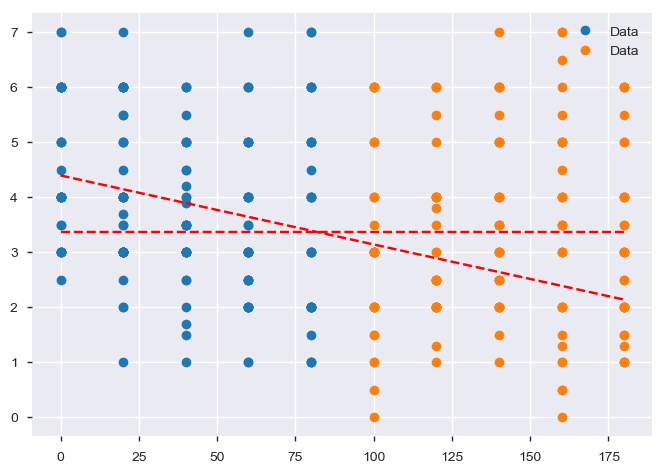

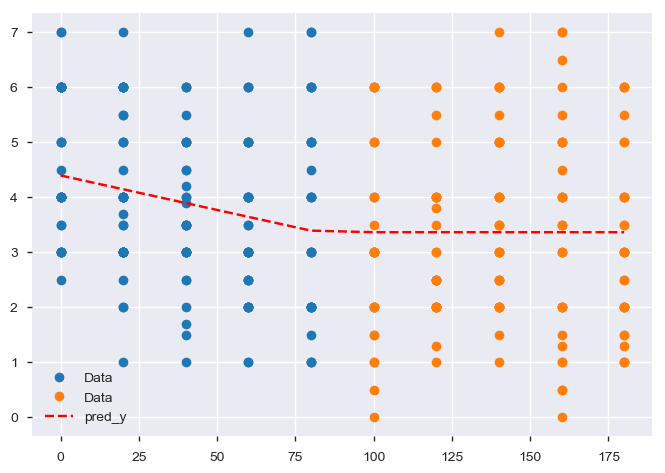

,subject,phase_diff,magnitude,phase_diff_radian,fittedvalues,x_x,res,abs_res,x_y,pred_y
0,渡邉君,180,4.0,3.141593,3.442606,180,0.723737,0.723737,180,3.362581
1,向畑君,180,1.5,3.141593,3.442606,180,-1.776263,1.776263,180,3.362581
2,上島君,180,1.5,3.141593,3.442606,180,-1.776263,1.776263,180,3.362581
3,横山君,180,1.0,3.141593,3.442606,180,-2.276263,2.276263,180,3.362581
4,横山君,180,2.0,3.141593,3.442606,180,-1.276263,1.276263,180,3.362581


train-mae 1.3139196645533624
test-mae 1.2392023866434292


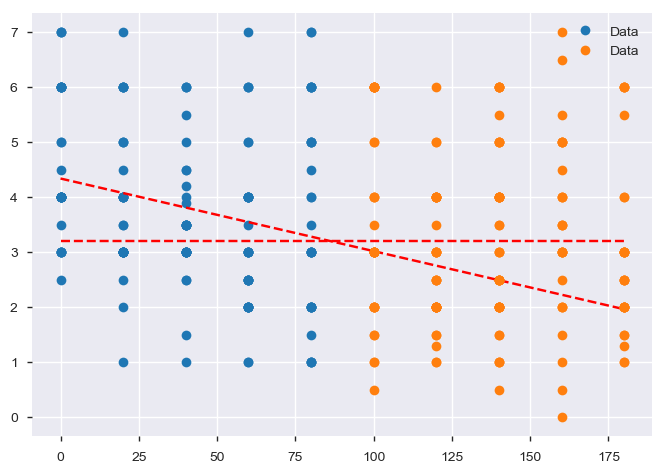

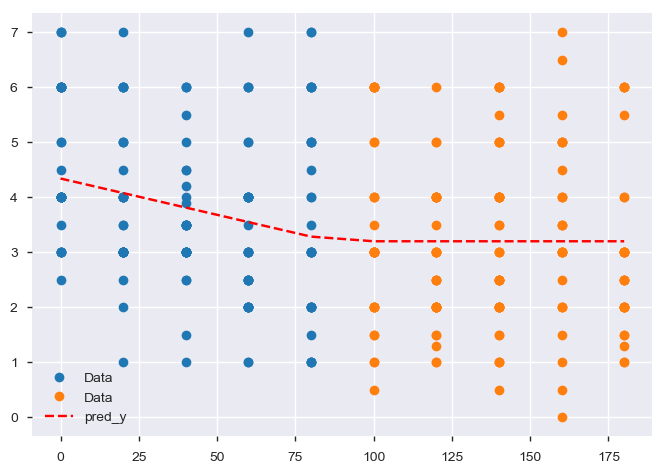

,subject,phase_diff,magnitude,phase_diff_radian,fittedvalues,x_x,res,abs_res,x_y,pred_y
0,向畑君,180,1.5,3.141593,3.442606,180,-1.776263,1.776263,180,3.198148
1,上島君,180,1.5,3.141593,3.442606,180,-1.776263,1.776263,180,3.198148
2,横山君,180,2.0,3.141593,3.442606,180,-1.276263,1.276263,180,3.198148
3,梅津君,180,4.0,3.141593,3.442606,180,0.723737,0.723737,180,3.198148
4,仙石君,180,6.0,3.141593,3.442606,180,2.723737,2.723737,180,3.198148


train-mae 1.2479509946100622
test-mae 1.4138964326115007


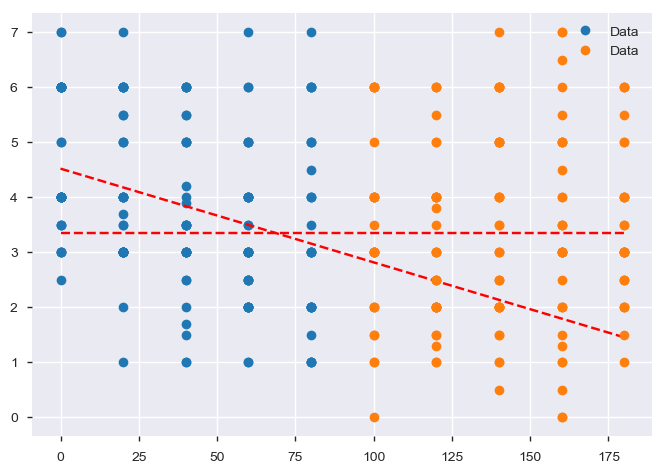

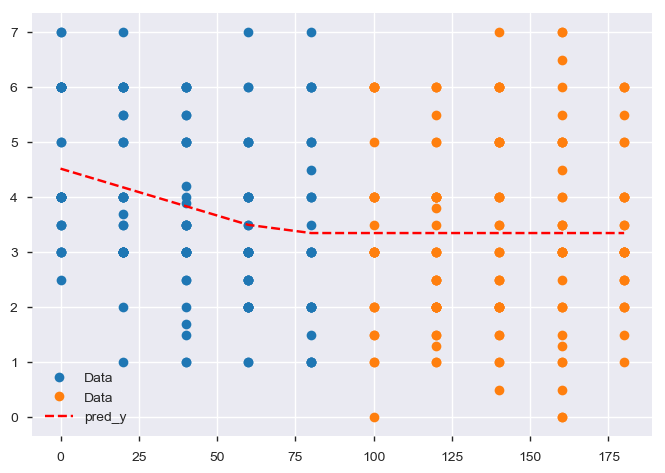

,subject,phase_diff,magnitude,phase_diff_radian,fittedvalues,x_x,res,abs_res,x_y,pred_y
0,渡邉君,180,4.0,3.141593,3.442606,180,0.723737,0.723737,180,3.347742
1,上島君,180,1.5,3.141593,3.442606,180,-1.776263,1.776263,180,3.347742
2,横山君,180,1.0,3.141593,3.442606,180,-2.276263,2.276263,180,3.347742
3,横山君,180,2.0,3.141593,3.442606,180,-1.276263,1.276263,180,3.347742
4,梅津君,180,4.0,3.141593,3.442606,180,0.723737,0.723737,180,3.347742


train-mae 1.2986713822719655
test-mae 1.2846628494562686


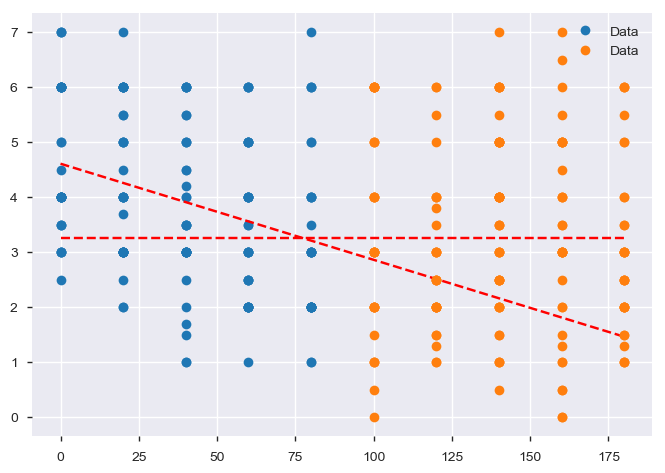

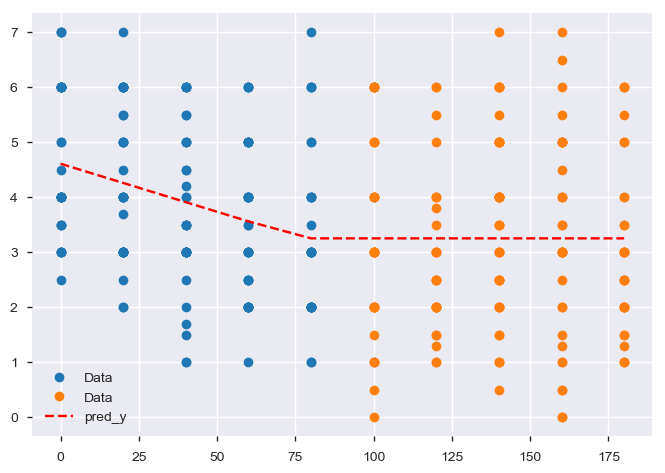

,subject,phase_diff,magnitude,phase_diff_radian,fittedvalues,x_x,res,abs_res,x_y,pred_y
0,渡邉君,180,4.0,3.141593,3.442606,180,0.723737,0.723737,180,3.251235
1,向畑君,180,1.5,3.141593,3.442606,180,-1.776263,1.776263,180,3.251235
2,上島君,180,1.5,3.141593,3.442606,180,-1.776263,1.776263,180,3.251235
3,横山君,180,1.0,3.141593,3.442606,180,-2.276263,2.276263,180,3.251235
4,横山君,180,2.0,3.141593,3.442606,180,-1.276263,1.276263,180,3.251235


train-mae 1.3129805369820802
test-mae 1.221487431558241


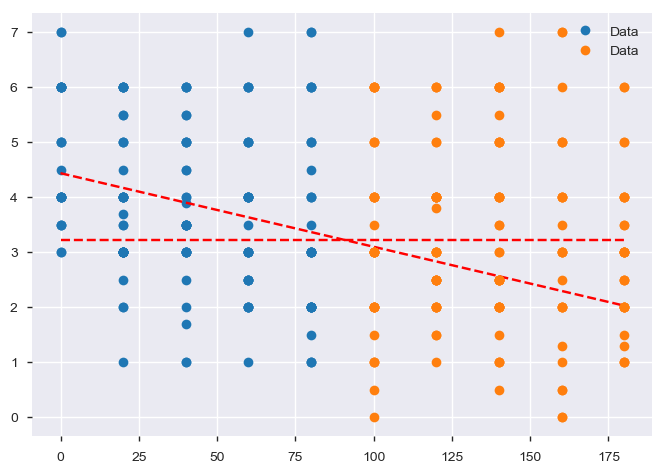

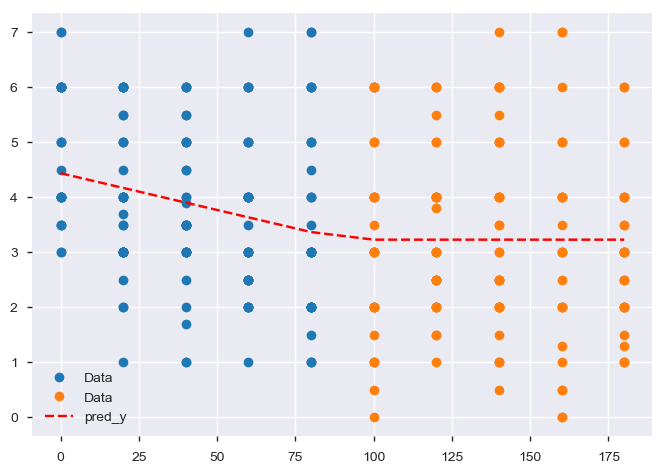

,subject,phase_diff,magnitude,phase_diff_radian,fittedvalues,x_x,res,abs_res,x_y,pred_y
0,渡邉君,180,4.0,3.141593,3.442606,180,0.723737,0.723737,180,3.227215
1,向畑君,180,1.5,3.141593,3.442606,180,-1.776263,1.776263,180,3.227215
2,横山君,180,1.0,3.141593,3.442606,180,-2.276263,2.276263,180,3.227215
3,梅津君,180,4.0,3.141593,3.442606,180,0.723737,0.723737,180,3.227215
4,仙石君,180,6.0,3.141593,3.442606,180,2.723737,2.723737,180,3.227215


train-mae 1.273426878706654
test-mae 1.3612289127835686


In [69]:
#cv
#方法1
kf_random = KFold(n_splits = 5,shuffle = True)
cv_resultsummary = []
cv_resultdata = []
cv_scores_rmse = []
cv_scores_mae_2sys = []
cv_figs = []
train_scores_2sys = []

for train_index, test_index in kf_random.split(data):
    train_data= data.loc[train_index,:]
    test_data = data.loc[test_index,:]

    left_data = train_data.loc[train_data["phase_diff"] < 90,:]
    right_data = train_data.loc[train_data["phase_diff"] > 90,:]
    
    left_results = smf.ols("magnitude ~ phase_diff", data = left_data).fit()
    
    left_data.loc[:,"fittedvalues"] = left_results.fittedvalues
    left_x = pd.DataFrame({"phase_diff":[0,20,40,60,80,100,120,140,160,180]})
    left_y = left_results.predict(x)
    left_xx = left_data["phase_diff"].reset_index(drop=True)
    left_yy = left_data["magnitude"].reset_index(drop=True)


    X = [1]*right_data.shape[0]
    Y = right_data["magnitude"]
    right_results = sm.OLS(Y,X).fit()
    right_data.loc[:,"fittedvalues"] = right_results.fittedvalues
    right_x = pd.DataFrame({"phase_diff":[0,20,40,60,80,100,120,140,160,180]})
    right_y = [right_results.params[0]]*x.shape[0]
    right_xx = right_data["phase_diff"].reset_index(drop=True)
    right_yy = right_data["magnitude"].reset_index(drop=True)
    

    
    plt.plot(left_xx, left_yy, 'o', label="Data")
    plt.plot(left_x, left_y, 'r--')

    plt.plot(right_xx, right_yy, 'o', label="Data")
    plt.plot(right_x, right_y, 'r--')
    
    plt.legend(loc="best")
    #plt.savefig('figure/figure' + str(i) + '.png')
    plt.show()
    
    upper_y = (left_y > right_y)*left_y + (left_y < right_y)*right_y
    upper_x = left_x
    
    upper_df = pd.DataFrame(upper_x)
    upper_df["y"] = upper_y
    upper_df.columns = ["x","pred_y"]

    plt.plot(left_xx, left_yy, 'o', label="Data")

    plt.plot(right_xx, right_yy, 'o', label="Data")

    plt.plot(upper_df["x"], upper_df["pred_y"], 'r--')
    

    plt.legend(loc="best")
    #plt.savefig('figure/figure' + str(i) + '.png')
    plt.show()
    

    train_data = train_data.drop("pred_y", axis=1)
    test_data = test_data.drop("pred_y",axis=1)

    train_result = pd.merge(train_data,upper_df,left_on="phase_diff",right_on="x")
    display(train_result.head())
    train_result["res"] = train_result["magnitude"]-train_result["pred_y"]
    train_result["abs_res"] = np.abs(train_result["magnitude"]-train_result["pred_y"])
    train_mae = train_result["abs_res"].mean()
    
    test_result = pd.merge(test_data,upper_df,left_on="phase_diff",right_on="x")
    test_result["res"] = test_result["magnitude"]-test_result["pred_y"]
    test_result["abs_res"] = np.abs(test_result["magnitude"]-test_result["pred_y"])
    test_mae = test_result["abs_res"].mean()
    
    cv_scores_mae_2sys.append(test_mae)
    train_scores_2sys.append(train_mae)

    print("train-mae",train_mae)
    print("test-mae",test_mae)

In [70]:
cv_scores_mae_2sys

[1.2392023866434292,
 1.4138964326115007,
 1.2846628494562686,
 1.221487431558241,
 1.3612289127835686]

In [71]:
pd.DataFrame(cv_scores_mae_2sys).mean()

0    1.304096
dtype: float64

In [72]:
train_scores_2sys

[1.3139196645533624,
 1.2479509946100622,
 1.2986713822719655,
 1.3129805369820802,
 1.273426878706654]

In [73]:
pd.DataFrame(train_scores_2sys).mean()

0    1.28939
dtype: float64

# 1～１０次の回帰式からcv値を最小にするものを選ぶ

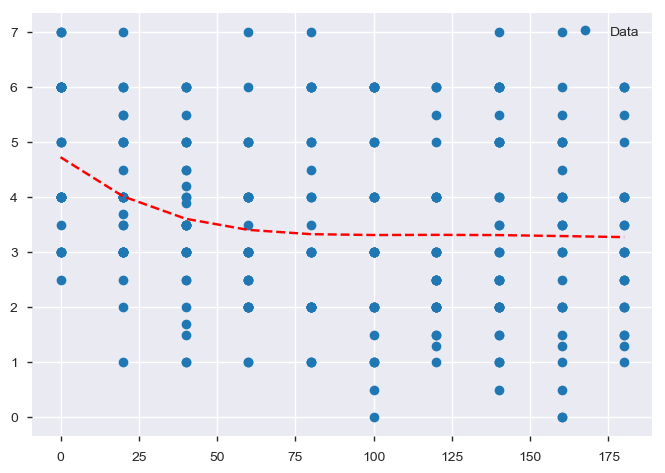

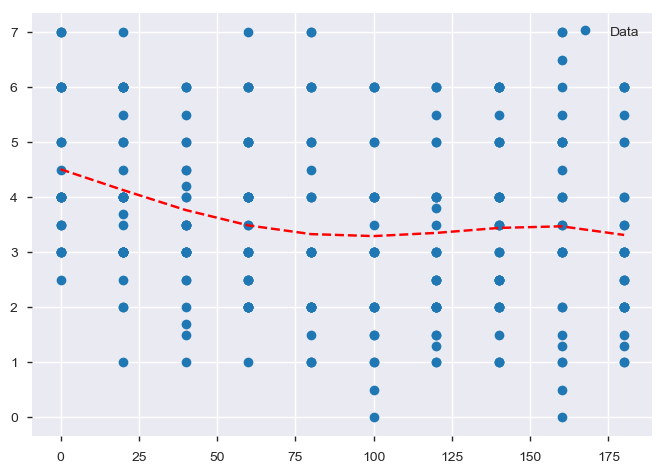

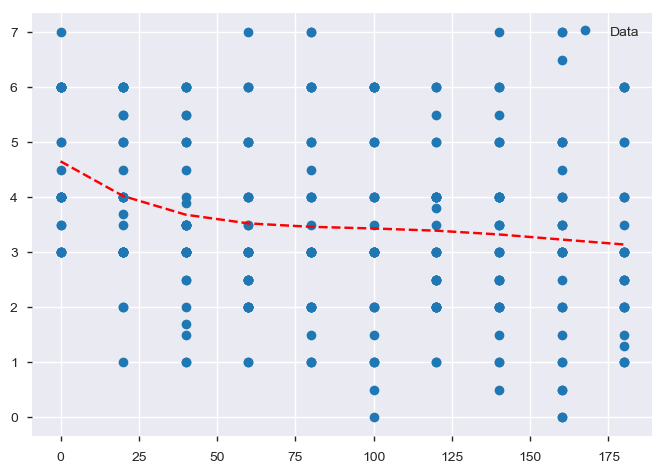

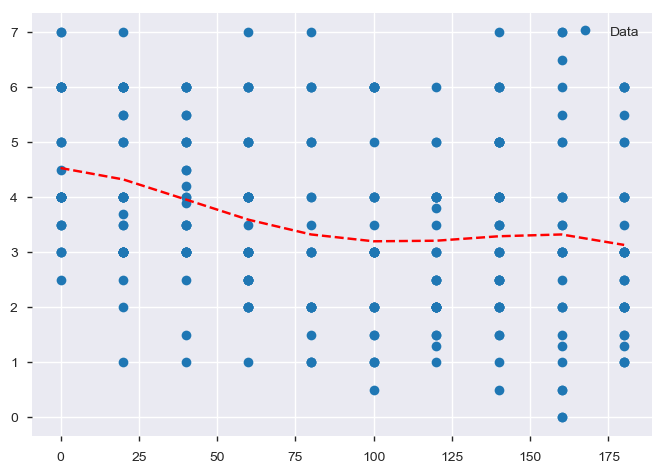

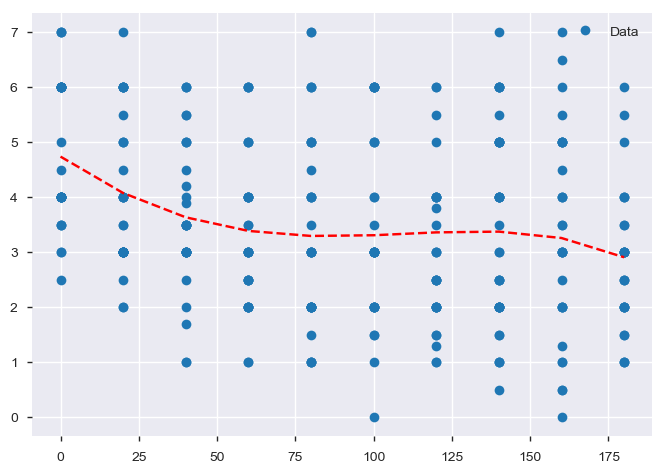

In [74]:
#indexで5Foldに分ける
cv_rand_results = []
cv_rand_preds = []
cv_rand_scores_rmse = []
cv_rand_scores_mae4 = []

train_scores4 = []


formula = "magnitude ~ phase_diff + I(phase_diff**2) + I(phase_diff**3) + I(phase_diff**4)"



for train_index, test_index in kf_random.split(data):
    data_train = data.loc[train_index,:]
    data_test = data.loc[test_index,:]
    
    results = smf.ols(formula , data = data_train).fit()
    cv_rand_results.append(results)
    
    train_scores4.append(np.abs(results.resid).mean())

    
    y_pred = results.predict(data_test)
    cv_rand_preds.append(y_pred)
    
    y_test = data_test["magnitude"].values
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    cv_rand_scores_rmse.append(rmse)
    mae = mean_absolute_error(y_test, y_pred)
    cv_rand_scores_mae4.append(mae)
    
    data_train.loc[:,"fittedvalues"] = results.fittedvalues
    x = pd.DataFrame({"phase_diff":[0,20,40,60,80,100,120,140,160,180]})
    y = results.predict(x)
    
    xx = data_train["phase_diff"]
    yy = data_train["magnitude"]
    
    plt.plot(xx, yy, 'o', label="Data")
    plt.plot(x, y, 'r--')
    
    plt.legend(loc="best")
    plt.savefig('figure/figure' + str(i) + '.png')
    plt.show()
    

In [75]:
print(cv_rand_scores_mae4)
pd.DataFrame(cv_rand_scores_mae4).mean()

[1.2734773062323645, 1.2310821264482343, 1.3097451507427418, 1.415748470649785, 1.295981696206584]


0    1.305207
dtype: float64

In [76]:
print(train_scores4)
pd.DataFrame(train_scores4).mean()

[1.288376371008706, 1.3064230769262795, 1.2833963423902113, 1.262998116380708, 1.2789392790946188]


0    1.284027
dtype: float64

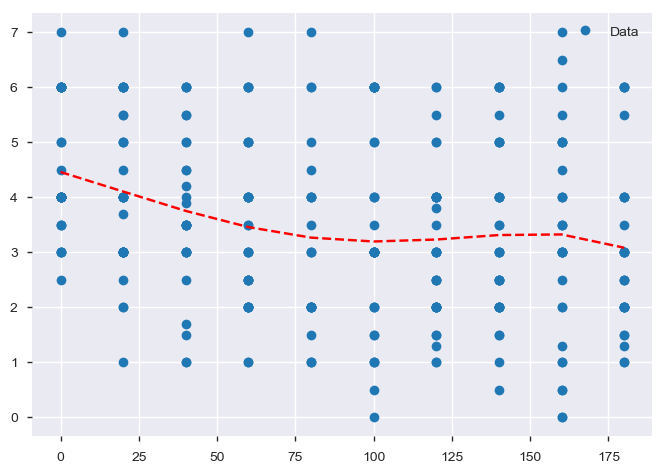

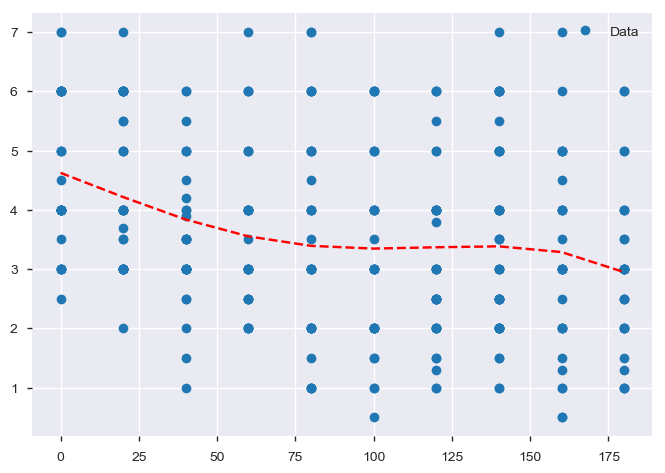

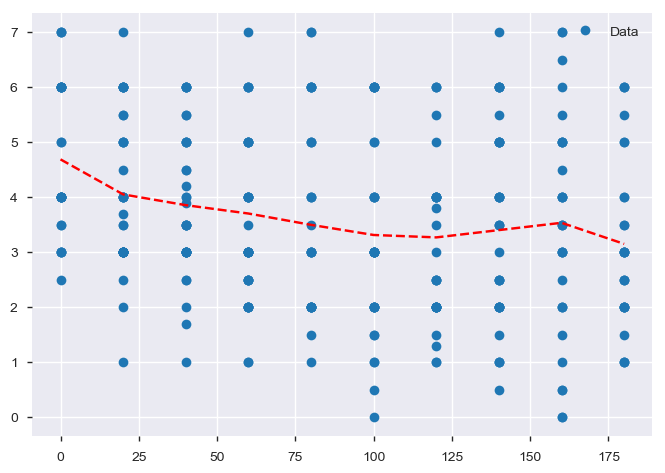

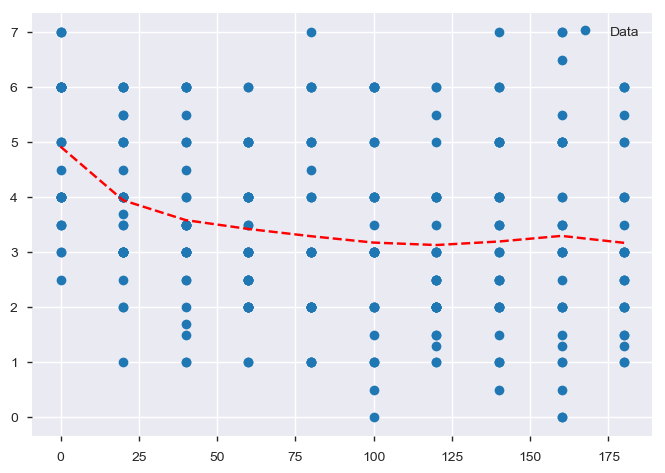

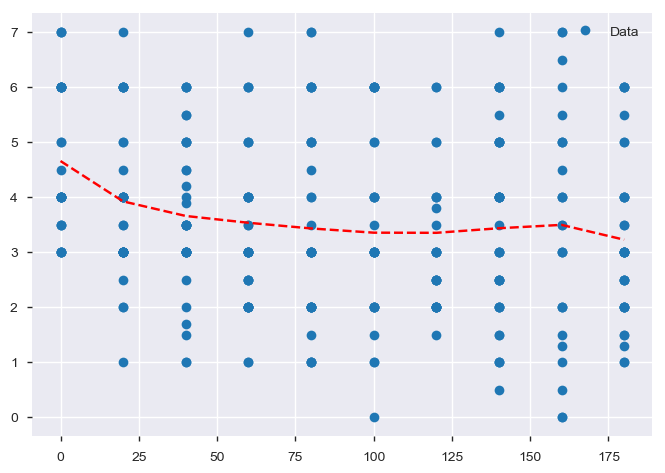

In [77]:
#indexで5Foldに分ける
cv_rand_results = []
cv_rand_preds = []
cv_rand_scores_rmse = []
cv_rand_scores_mae5 = []

train_scores5 = []


formula = "magnitude ~ phase_diff + I(phase_diff**2) + I(phase_diff**3)  + I(phase_diff**4)+ I(phase_diff**5)"



for train_index, test_index in kf_random.split(data):
    data_train = data.loc[train_index,:]
    data_test = data.loc[test_index,:]
    
    results = smf.ols(formula , data = data_train).fit()
    cv_rand_results.append(results)
    
    train_scores5.append(np.abs(results.resid).mean())

    
    y_pred = results.predict(data_test)
    cv_rand_preds.append(y_pred)
    
    y_test = data_test["magnitude"].values
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    cv_rand_scores_rmse.append(rmse)
    mae = mean_absolute_error(y_test, y_pred)
    cv_rand_scores_mae5.append(mae)
    
    data_train.loc[:,"fittedvalues"] = results.fittedvalues
    x = pd.DataFrame({"phase_diff":[0,20,40,60,80,100,120,140,160,180]})
    y = results.predict(x)
    
    xx = data_train["phase_diff"]
    yy = data_train["magnitude"]
    
    plt.plot(xx, yy, 'o', label="Data")
    plt.plot(x, y, 'r--')
    
    plt.legend(loc="best")
    plt.savefig('figure/figure' + str(i) + '.png')
    plt.show()
    

In [78]:
print(cv_rand_scores_mae5)
pd.DataFrame(cv_rand_scores_mae5).mean()

[1.3045576259428249, 1.5212957800928275, 1.1233615118850089, 1.3358834636382377, 1.2463923080820547]


0    1.306298
dtype: float64

In [79]:
print(train_scores5)
pd.DataFrame(train_scores5).mean()

[1.2719694616272679, 1.234250465329212, 1.3352715794832826, 1.2639171803410811, 1.2991538137988792]


0    1.280913
dtype: float64

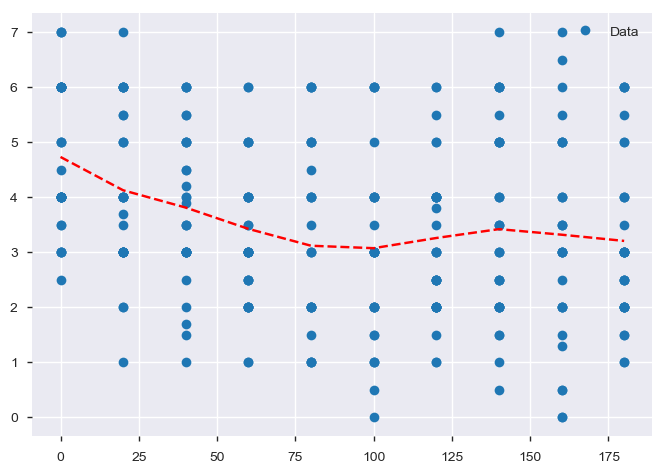

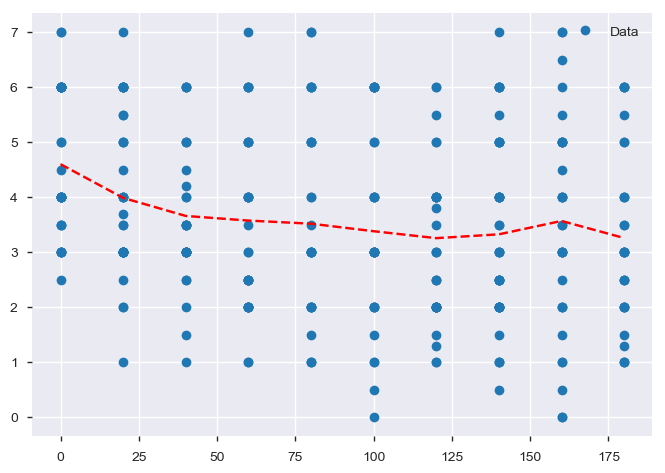

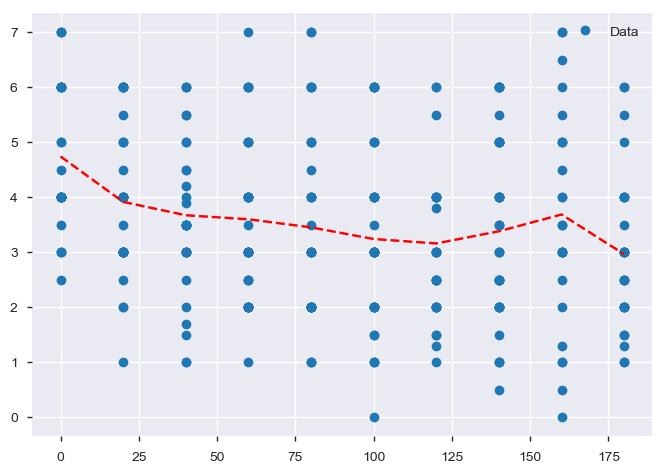

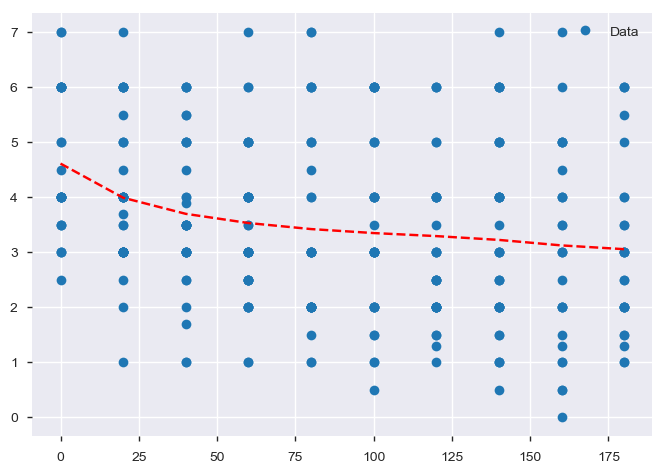

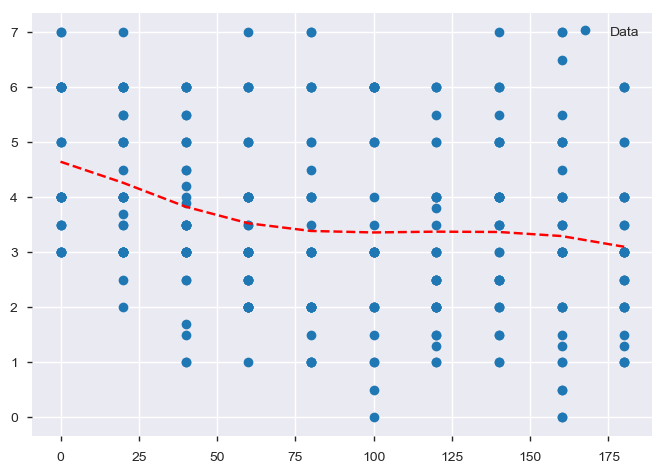

In [80]:
#indexで5Foldに分ける
cv_rand_results = []
cv_rand_preds = []
cv_rand_scores_rmse = []
cv_rand_scores_mae6 = []

train_scores6 = []


formula = "magnitude ~ phase_diff + I(phase_diff**2) + I(phase_diff**3)  + I(phase_diff**4)+ I(phase_diff**5)+ I(phase_diff**6)"



for train_index, test_index in kf_random.split(data):
    data_train = data.loc[train_index,:]
    data_test = data.loc[test_index,:]
    
    results = smf.ols(formula , data = data_train).fit()
    cv_rand_results.append(results)
    
    train_scores6.append(np.abs(results.resid).mean())

    
    y_pred = results.predict(data_test)
    cv_rand_preds.append(y_pred)
    
    y_test = data_test["magnitude"].values
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    cv_rand_scores_rmse.append(rmse)
    mae = mean_absolute_error(y_test, y_pred)
    cv_rand_scores_mae6.append(mae)
    
    data_train.loc[:,"fittedvalues"] = results.fittedvalues
    x = pd.DataFrame({"phase_diff":[0,20,40,60,80,100,120,140,160,180]})
    y = results.predict(x)
    
    xx = data_train["phase_diff"]
    yy = data_train["magnitude"]
    
    plt.plot(xx, yy, 'o', label="Data")
    plt.plot(x, y, 'r--')
    
    plt.legend(loc="best")
    plt.savefig('figure/figure' + str(i) + '.png')
    plt.show()
    

In [81]:
print(cv_rand_scores_mae6)
pd.DataFrame(cv_rand_scores_mae6).mean()

[1.373843594082008, 1.0782850305534757, 1.3941493364592836, 1.3553703606168899, 1.315368041949408]


0    1.303403
dtype: float64

In [82]:
print(train_scores5)
pd.DataFrame(train_scores5).mean()

[1.2719694616272679, 1.234250465329212, 1.3352715794832826, 1.2639171803410811, 1.2991538137988792]


0    1.280913
dtype: float64

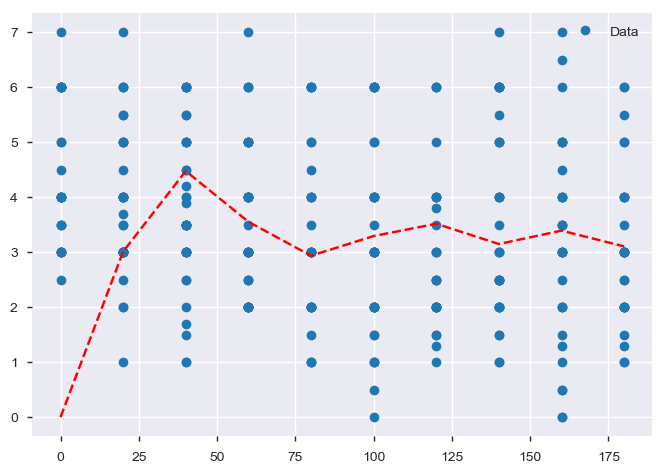

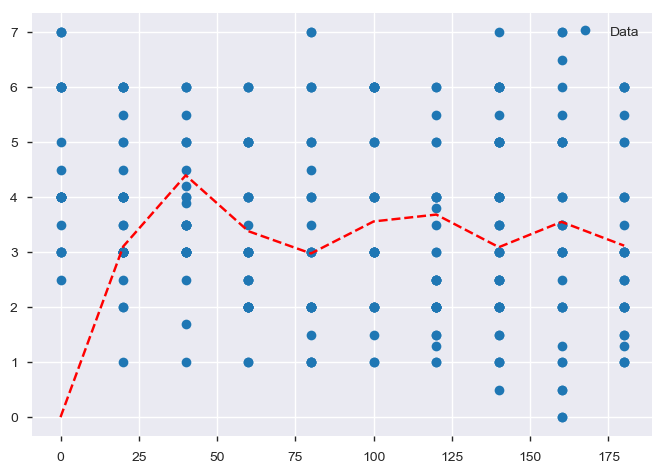

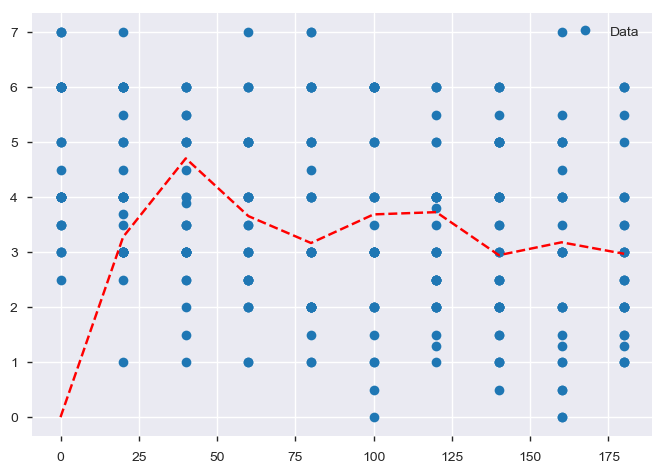

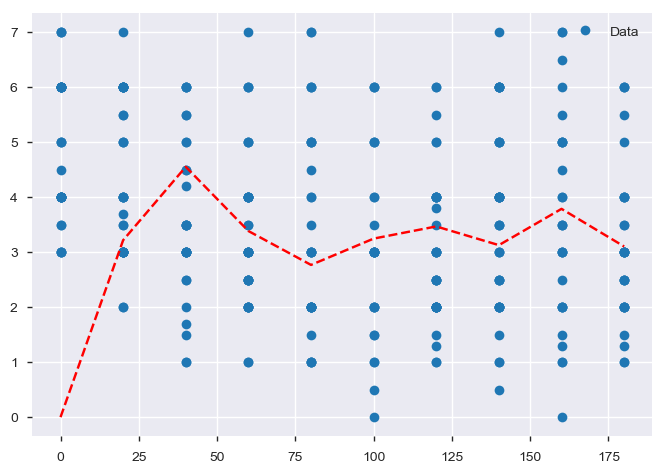

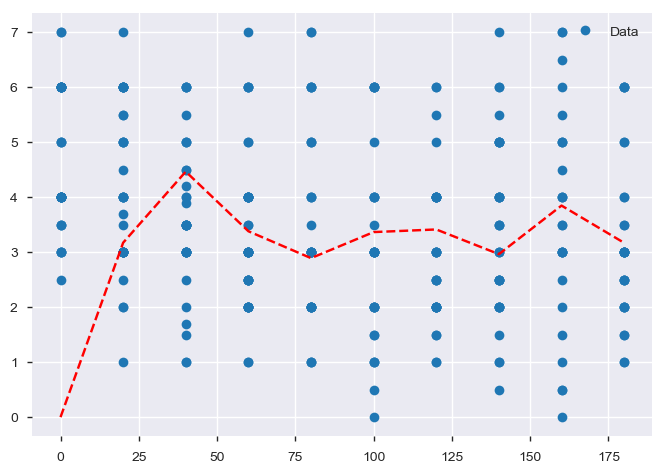

In [83]:
#indexで5Foldに分ける
cv_rand_results = []
cv_rand_preds = []
cv_rand_scores_rmse = []
cv_rand_scores_mae7 = []

train_scores7 = []


formula = "magnitude ~ phase_diff + I(phase_diff**2) + I(phase_diff**3)  + I(phase_diff**4)+ I(phase_diff**5)+ I(phase_diff**6)+ I(phase_diff**7)"



for train_index, test_index in kf_random.split(data):
    data_train = data.loc[train_index,:]
    data_test = data.loc[test_index,:]
    
    results = smf.ols(formula , data = data_train).fit()
    cv_rand_results.append(results)
    
    train_scores7.append(np.abs(results.resid).mean())

    
    y_pred = results.predict(data_test)
    cv_rand_preds.append(y_pred)
    
    y_test = data_test["magnitude"].values
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    cv_rand_scores_rmse.append(rmse)
    mae = mean_absolute_error(y_test, y_pred)
    cv_rand_scores_mae7.append(mae)
    
    data_train.loc[:,"fittedvalues"] = results.fittedvalues
    x = pd.DataFrame({"phase_diff":[0,20,40,60,80,100,120,140,160,180]})
    y = results.predict(x)
    
    xx = data_train["phase_diff"]
    yy = data_train["magnitude"]
    
    plt.plot(xx, yy, 'o', label="Data")
    plt.plot(x, y, 'r--')
    
    plt.legend(loc="best")
    plt.savefig('figure/figure' + str(i) + '.png')
    plt.show()
    

In [84]:
print(cv_rand_scores_mae7)
pd.DataFrame(cv_rand_scores_mae7).mean()

[1.9771908177369142, 1.7412374757997209, 1.507910664197682, 1.5183703183021313, 1.6457644809661147]


0    1.678095
dtype: float64

In [85]:
print(train_scores7)
pd.DataFrame(train_scores7).mean()

[1.5623460065409365, 1.6254914226173698, 1.702776740457964, 1.6823858122989506, 1.648964410806129]


0    1.644393
dtype: float64

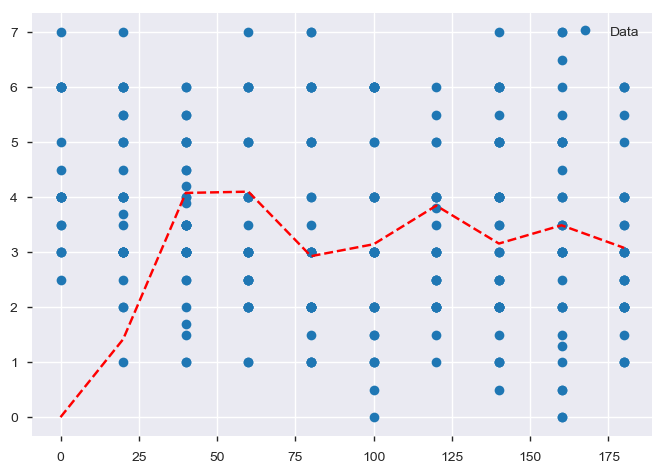

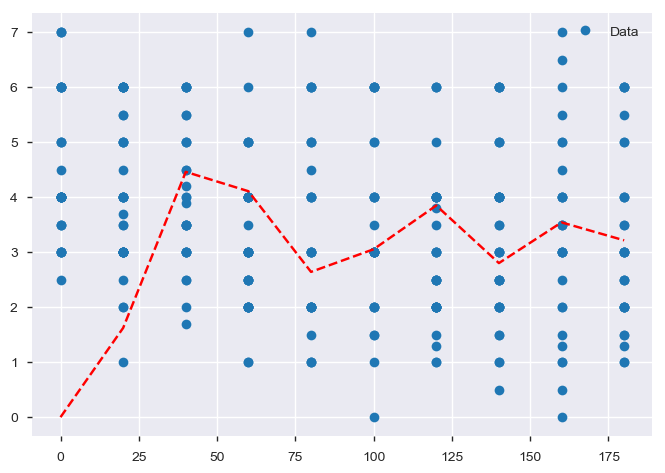

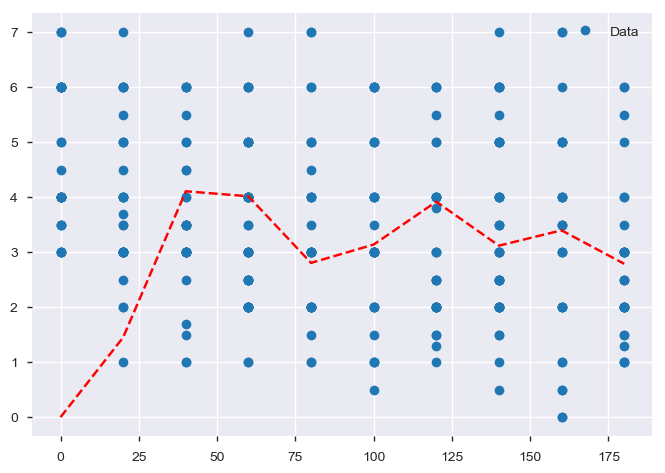

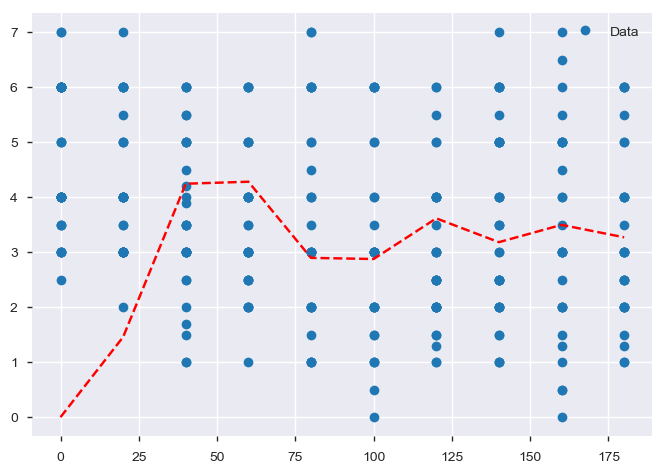

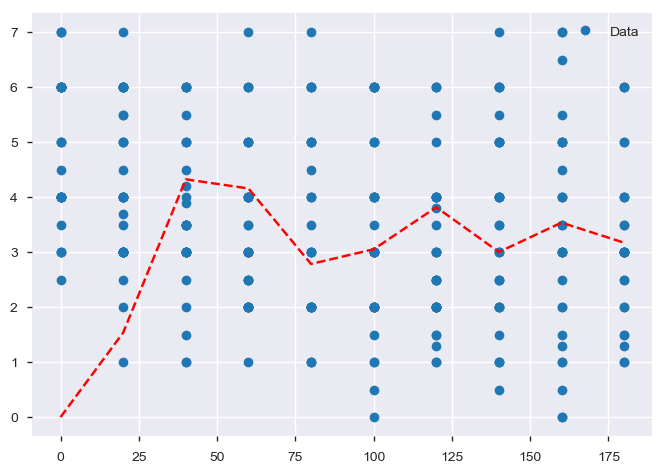

In [86]:
#indexで5Foldに分ける
cv_rand_results = []
cv_rand_preds = []
cv_rand_scores_rmse = []
cv_rand_scores_mae8 = []

train_scores8 = []


formula = "magnitude ~ phase_diff + I(phase_diff**2) + I(phase_diff**3)  + I(phase_diff**4)+ I(phase_diff**5)+ I(phase_diff**6)+ I(phase_diff**7)+ I(phase_diff**8)"



for train_index, test_index in kf_random.split(data):
    data_train = data.loc[train_index,:]
    data_test = data.loc[test_index,:]
    
    results = smf.ols(formula , data = data_train).fit()
    cv_rand_results.append(results)
    
    train_scores8.append(np.abs(results.resid).mean())

    
    y_pred = results.predict(data_test)
    cv_rand_preds.append(y_pred)
    
    y_test = data_test["magnitude"].values
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    cv_rand_scores_rmse.append(rmse)
    mae = mean_absolute_error(y_test, y_pred)
    cv_rand_scores_mae8.append(mae)
    
    data_train.loc[:,"fittedvalues"] = results.fittedvalues
    x = pd.DataFrame({"phase_diff":[0,20,40,60,80,100,120,140,160,180]})
    y = results.predict(x)
    
    xx = data_train["phase_diff"]
    yy = data_train["magnitude"]
    
    plt.plot(xx, yy, 'o', label="Data")
    plt.plot(x, y, 'r--')
    
    plt.legend(loc="best")
    plt.savefig('figure/figure' + str(i) + '.png')
    plt.show()
    

In [87]:
print(cv_rand_scores_mae8)
pd.DataFrame(cv_rand_scores_mae8).mean()

[2.1329916844448102, 1.9716120378084592, 1.9159370901895318, 1.5905146438522089, 1.5640660742794972]


0    1.835024
dtype: float64

In [88]:
print(train_scores8)
pd.DataFrame(train_scores8).mean()

[1.731382458978938, 1.7796994068362841, 1.7838581573856658, 1.8818195270978275, 1.878067869709505]


0    1.810965
dtype: float64

# ゲシュタルトモデル

In [89]:
#閉合の要因の平行移動
def G1(x,a,c,d,bd):
    #x:scalar 説明変数
    #他は係数
    y = a*(1+math.cos(c*(x**d)))+bd
    return y

In [90]:
#閉合の要因の伸張
def G2(x,a,c,d,bd):
    y = a*(1-math.cos(c*x**d))+bd
    
    return y

In [91]:
#ためしにプロット
x = np.arange(0,3.5,0.1)
a1 = 1.3
c1 = 1.45
d1 = 0.4
bd1 = 2.1
a2 = 1.0
c2 = 1.1
d2 = 1.1
bd2 = 1.6
y1 = [G1(x,a=a1,c=c1,d=d1,bd=bd1) for x in x]
y2 = [G2(x,a=a2,c=c2,d=d2,bd=bd2) for x in x]
# Create a trace
trace1 = go.Scatter(
    x = x,
    y = y1,
)
trace2 = go.Scatter(
    x = x,
    y = y2,
)
trace3 = go.Scatter(
    x = data["phase_diff_radian"],
    y = data["magnitude"],
    mode = 'markers'
)
data_plt = [trace1, trace2, trace3]
plotly.offline.iplot(data_plt)

## 係数決定　Gridsearchする

In [92]:
#係数はGridsearchで決める

def get_upper(y1, y2):
    #y1, y2 :numpy
    mask = np.array(y1) > np.array(y2)
    y = y1*mask+y2*(1-mask)
    return y



In [93]:
pars = []

a1_list = np.arange(1,1.5,0.1)
a2_list = np.arange(0.9,1.1,0.1)
c1_list = np.arange(1.4,1.5,0.05)
c2_list = np.arange(1,1.2,0.1)
d1_list = np.arange(0.3,0.5,0.1)
d2_list = np.arange(1,1.2,0.1)
bd1_list = np.arange(2,2.2,0.1)
bd2_list = np.arange(1.5,1.7,0.1)

for a1 in a1_list:

    for a2 in a2_list:

        for c1 in c1_list:

            for c2 in c2_list:

                for d1 in d1_list:

                    for d2 in d2_list:
                        
                        for bd1 in bd1_list:
                            
                            for bd2 in bd2_list:

                                pars.append({'a1': a1, 'a2': a2, 

                                         'c1': c1, 'c2': c2,

                                         'd1': d1, 'd2': d2, 

                                         'bd1': bd1, 'bd2' : bd2})
patterns = len(a1_list)*len(a2_list)*len(c1_list)*len(c2_list)*len(d1_list)*len(d2_list)*len(bd1_list)*len(bd2_list)

print(patterns)

2160


In [94]:
par = pars[0]
par

{'a1': 1.0,
 'a2': 0.9,
 'c1': 1.4,
 'c2': 1.0,
 'd1': 0.3,
 'd2': 1.0,
 'bd1': 2.0,
 'bd2': 1.5}

In [95]:
y1 = [G1(x,a=par["a1"],c=par["c1"],d=par["d1"],bd=par["bd1"]) for x in x]
y2 = [G2(x,a=par["a2"],c=par["c2"],d=par["d2"],bd=par["bd2"]) for x in x]

y = get_upper(y1,y2)
print(y)

# Create a trace
trace1 = go.Scatter(
    x = x,
    y = y1,
    line = dict(
        dash = 'dash')
)
trace2 = go.Scatter(
    x = x,
    y = y2,
    line = dict(
        dash = 'dash')
)

trace3 = go.Scatter(
    x = x,
    y = y,
)

trace4 = go.Scatter(
    x = data["phase_diff_radian"],
    y = data["magnitude"],
    mode = 'markers'
)
data_plt = [trace1, trace2, trace3, trace4]
plotly.offline.iplot(data_plt)

[4.         3.76377036 3.64951692 3.56068506 3.48579757 3.42017937
 3.36134714 3.3077844  3.2584801  3.21271792 3.16996714 3.12982082
 3.09195827 3.05612118 3.02209757 2.9897108  2.95881172 2.92927293
 2.90098454 2.87385089 2.84778811 2.85436149 2.92965101 2.99964842
 3.06365434 3.12102925 3.17119988 3.21366493 3.24800011 3.27386235
 3.29099325 3.29922164 3.2984653  3.28873179 3.27011837]


In [96]:
#MAE計算
x = np.array([0,20,40,60,80,100,120,140,160,180])
predict1 = [G1(x,a=par["a1"],c=par["c1"],d=par["d1"],bd=par["bd1"]) for x in x]
predict2 = [G2(x,a=par["a1"],c=par["c1"],d=par["d1"],bd=par["bd1"]) for x in x]
predict = get_upper(predict1,predict2)
predict_df = pd.DataFrame(x)
predict_df.columns = ["phase_diff_radian"]
predict_df.loc[:,"predict"] = predict
predict_df.head()

,phase_diff_radian,predict
0,0,4.000000
1,20,3.956088
2,40,3.460391
3,60,3.069158
4,80,3.479617


In [97]:
result = pd.merge(data,predict_df,on="phase_diff_radian")
result["res"] = np.abs(result["magnitude"] - result["predict"])
result.head()

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation



,subject,phase_diff,magnitude,phase_diff_radian,fittedvalues,x,pred_y,res,abs_res,predict
0,上島君,0,3.5,0.0,4.571242,0,4.460599,0.5,0.960599,4.0
1,梅津君,0,6.0,0.0,4.571242,0,4.460599,2.0,1.539401,4.0
2,池田君,0,4.0,0.0,4.571242,0,4.460599,0.0,0.460599,4.0
3,仙石君,0,3.0,0.0,4.571242,0,4.460599,1.0,1.460599,4.0
4,志村君,0,5.0,0.0,4.571242,0,4.460599,1.0,0.539401,4.0


In [98]:
mae = result["res"].mean()
mae

1.0945945945945945

In [99]:
#方法1
kf_random = KFold(n_splits = 5,shuffle = True)
kf_random.get_n_splits(data)
print(kf_random)
for train_index, test_index in kf_random.split(data):
    print("TRAIN:", train_index, "TEST:", test_index)
    print("train len", len(train_index), "test len", len(test_index))

KFold(n_splits=5, random_state=None, shuffle=True)
TRAIN: [  0   1   2   3   4   5   6   8  11  12  13  14  15  16  18  19  20  22
  23  24  26  27  28  29  30  31  32  33  34  36  37  38  39  40  41  42
  43  44  45  46  47  49  50  51  52  53  56  57  58  59  61  62  63  65
  68  69  70  71  72  74  78  79  80  81  82  83  84  85  87  89  90  93
  94  95  96  98  99 100 101 102 103 105 106 107 108 109 110 111 112 114
 116 117 118 119 121 123 124 126 127 128 129 130 132 133 134 135 136 137
 138 139 140 141 142 143 144 145 146 147 148 149 150 152 153 154 155 157
 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176
 177 179 180 181 182 183 184 185 188 190 191 192 193 195 196 197 198 199
 201 202 204 206 207 208 210 213 215 216 217 219 220 221 223 224 225 227
 228 229 230 231 233 234 235 236 237 238 239 240 242 243 244 245 246 247
 248 249 251 253 254 255 256 257 258 259 260 261 263 264 265 266 268 269
 271 273 274 275 276 277 279 280 283 284 285 286 287 288 289 290 2

In [100]:
#cvの中それぞれでgridsearchする

train_g_scores = []
test_g_scores = []
best_params = []

num_fold = 0

for train_index, test_index in kf_random.split(data):
    print("n_fold: ", num_fold)
    
    train = data.loc[train_index, :]
    test = data.loc[test_index, :]
    
    in_fold_train_scores = []
    in_fold_test_scores = []
    
    for par in pars:
        
        #MAE計算
    
        x = np.array([0,20,40,60,80,100,120,140,160,180])
        predict1 = [G1(x,a=par["a1"],c=par["c1"],d=par["d1"],bd=par["bd1"]) for x in x]
        predict2 = [G2(x,a=par["a1"],c=par["c1"],d=par["d1"],bd=par["bd1"]) for x in x]
        predict = get_upper(predict1, predict2)
        predict_df = pd.DataFrame(x)
        predict_df.columns = ["phase_diff_radian"]
        predict_df.loc[:, "predict"] = predict
        
        train_result = pd.merge(train, predict_df, on="phase_diff_radian")
        train_result["res"] = np.abs(train_result["magnitude"] - train_result["predict"])
        
        test_result = pd.merge(test, predict_df ,on="phase_diff_radian")
        test_result["res"] = np.abs(test_result["magnitude"] - test_result["predict"])
        
        train_mae = train_result["res"].mean()
        test_mae = test_result["res"].mean()
        in_fold_train_scores.append(train_mae)
        in_fold_test_scores.append(test_mae)
        

    train_min_mae = np.array(in_fold_train_scores).min()
    train_g_scores.append(train_min_mae)
    best_param = pars[np.argmin(in_fold_train_scores)]
    best_params.append(best_param)
    test_g_score = in_fold_test_scores[np.argmin(in_fold_train_scores)]
    test_g_scores.append(test_g_score)
    
    num_fold += 1
        
        
        
        

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

n_fold:  0


C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

n_fold:  1


C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

n_fold:  2


C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

n_fold:  3


C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

n_fold:  4


C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

In [101]:
print(test_g_scores)
print(np.array(test_g_scores).mean())

[0.9, 1.0909090909090908, 1.3125, 1.2857142857142858, 1.0833333333333333]
1.134491341991342


In [102]:
print(train_g_scores)
print(np.array(train_g_scores).mean())

[1.125, 1.0961538461538463, 1.0344827586206897, 1.05, 1.1451612903225807]
1.0901595790194234


In [103]:
best_params

[{'a1': 1.0,
  'a2': 0.9,
  'c1': 1.4,
  'c2': 1.0,
  'd1': 0.3,
  'd2': 1.0,
  'bd1': 2.0,
  'bd2': 1.5},
 {'a1': 1.0,
  'a2': 0.9,
  'c1': 1.4,
  'c2': 1.0,
  'd1': 0.3,
  'd2': 1.0,
  'bd1': 2.0,
  'bd2': 1.5},
 {'a1': 1.0,
  'a2': 0.9,
  'c1': 1.4,
  'c2': 1.0,
  'd1': 0.3,
  'd2': 1.0,
  'bd1': 2.0,
  'bd2': 1.5},
 {'a1': 1.0,
  'a2': 0.9,
  'c1': 1.4,
  'c2': 1.0,
  'd1': 0.3,
  'd2': 1.0,
  'bd1': 2.0,
  'bd2': 1.5},
 {'a1': 1.2000000000000002,
  'a2': 0.9,
  'c1': 1.4,
  'c2': 1.0,
  'd1': 0.3,
  'd2': 1.0,
  'bd1': 2.1,
  'bd2': 1.5}]

In [104]:
#ためしにプロット
x = np.arange(0,3.5,0.1)

for par in best_params:


    y1 = [G1(x,a=par["a1"],c=par["c1"],d=par["d1"],bd=par["bd1"]) for x in x]
    y2 = [G2(x,a=par["a2"],c=par["c2"],d=par["d2"],bd=par["bd2"]) for x in x]

    y = get_upper(y1,y2)
    print(y)

    # Create a trace
    trace1 = go.Scatter(
        x = x,
        y = y1,
        line = dict(
            dash = 'dash')
    )
    trace2 = go.Scatter(
        x = x,
        y = y2,
        line = dict(
            dash = 'dash')
    )

    trace3 = go.Scatter(
        x = x,
        y = y,
    )

    trace4 = go.Scatter(
        x = data["phase_diff_radian"],
        y = data["magnitude"],
        mode = 'markers'
    )
    data_plt = [trace1, trace2, trace3, trace4]
    plotly.offline.iplot(data_plt)

[4.         3.76377036 3.64951692 3.56068506 3.48579757 3.42017937
 3.36134714 3.3077844  3.2584801  3.21271792 3.16996714 3.12982082
 3.09195827 3.05612118 3.02209757 2.9897108  2.95881172 2.92927293
 2.90098454 2.87385089 2.84778811 2.85436149 2.92965101 2.99964842
 3.06365434 3.12102925 3.17119988 3.21366493 3.24800011 3.27386235
 3.29099325 3.29922164 3.2984653  3.28873179 3.27011837]


[4.         3.76377036 3.64951692 3.56068506 3.48579757 3.42017937
 3.36134714 3.3077844  3.2584801  3.21271792 3.16996714 3.12982082
 3.09195827 3.05612118 3.02209757 2.9897108  2.95881172 2.92927293
 2.90098454 2.87385089 2.84778811 2.85436149 2.92965101 2.99964842
 3.06365434 3.12102925 3.17119988 3.21366493 3.24800011 3.27386235
 3.29099325 3.29922164 3.2984653  3.28873179 3.27011837]


[4.         3.76377036 3.64951692 3.56068506 3.48579757 3.42017937
 3.36134714 3.3077844  3.2584801  3.21271792 3.16996714 3.12982082
 3.09195827 3.05612118 3.02209757 2.9897108  2.95881172 2.92927293
 2.90098454 2.87385089 2.84778811 2.85436149 2.92965101 2.99964842
 3.06365434 3.12102925 3.17119988 3.21366493 3.24800011 3.27386235
 3.29099325 3.29922164 3.2984653  3.28873179 3.27011837]


[4.         3.76377036 3.64951692 3.56068506 3.48579757 3.42017937
 3.36134714 3.3077844  3.2584801  3.21271792 3.16996714 3.12982082
 3.09195827 3.05612118 3.02209757 2.9897108  2.95881172 2.92927293
 2.90098454 2.87385089 2.84778811 2.85436149 2.92965101 2.99964842
 3.06365434 3.12102925 3.17119988 3.21366493 3.24800011 3.27386235
 3.29099325 3.29922164 3.2984653  3.28873179 3.27011837]


[4.5        4.21652443 4.0794203  3.97282207 3.88295709 3.80421524
 3.73361656 3.66934128 3.61017612 3.5552615  3.50396057 3.45578498
 3.41034992 3.36734541 3.32651708 3.28765296 3.25057406 3.21512752
 3.18118145 3.14862107 3.11734574 3.08726653 3.05830443 3.03038883
 3.06365434 3.12102925 3.17119988 3.21366493 3.24800011 3.27386235
 3.29099325 3.29922164 3.2984653  3.28873179 3.27011837]


# 中央値モデル

In [105]:
#cvの中それぞれでgridsearchする

train_mean_scores = []
test_mean_scores = []
best_params = []

num_fold = 0

for train_index, test_index in kf_random.split(data):
    print("n_fold: ", num_fold)
    
    train = data.loc[train_index, :]
    test = data.loc[test_index, :]
    
    in_fold_train_scores = []
    in_fold_test_scores = []
    

    #MAE計算

    x = np.array([0,20,40,60,80,100,120,140,160,180])
    predict = train.groupby("phase_diff_radian").mean()
    predict_df = pd.DataFrame(x)
    predict_df.columns = ["phase_diff_radian"]
    predict_df.loc[:, "predict"] = predict["magnitude"].values

    train_result = pd.merge(train, predict_df, on="phase_diff_radian")
    train_result["res"] = np.abs(train_result["magnitude"] - train_result["predict"])

    test_result = pd.merge(test, predict_df ,on="phase_diff_radian")
    test_result["res"] = np.abs(test_result["magnitude"] - test_result["predict"])

    train_mae = train_result["res"].mean()
    test_mae = test_result["res"].mean()
    
    test_mean_scores.append(test_mae)
    train_mean_scores.append(train_mae)
    
    num_fold += 1
        
        
        
        

n_fold:  0
n_fold:  1
n_fold:  2
n_fold:  3
n_fold:  4


C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\reshape\merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation

C:\Program

In [106]:
test_mean_scores

[1.3322981366459625,
 1.1666666666666667,
 1.2285714285714286,
 1.3922413793103448,
 0.9952380952380953]

In [107]:
train_mean_scores

[1.1550094517958411,
 1.149843912591051,
 1.1624489795918365,
 1.0570749108204516,
 1.1733333333333331]

# CV値の箱ひげ図

In [126]:
import plotly
plotly.offline.init_notebook_mode(connected=False)

In [127]:

trace1 =  plotly.graph_objs.Box(
    y= cv_rand_scores_mae1,
    boxmean=True,
    name="1次式")

trace_g =  plotly.graph_objs.Box(
    y= test_g_scores,
    boxmean=True,
    name="Geshtalt")

trace_mean =  plotly.graph_objs.Box(
    y= test_mean_scores,
    boxmean=True,
    name="mean")


# trace2 =  plotly.graph_objs.Box(
#     y=cv_rand_scores_mae2,
#     name="2次式",
#     boxmean='sd')
# trace3 =  plotly.graph_objs.Box(
#     y=cv_rand_scores_mae3,
#     name="3次式",
#     boxmean='sd')
# trace4 =  plotly.graph_objs.Box(
#     y= cv_rand_scores_mae4,
#     name="4次式",
#     boxmean='sd')
# trace5 =  plotly.graph_objs.Box(
#     y= cv_rand_scores_mae5,
#     name="5次式",
#     boxmean='sd')
# trace6 =  plotly.graph_objs.Box(
#     y= cv_rand_scores_mae6,
#     name="6次式",
#     boxmean='sd')
# trace7 =  plotly.graph_objs.Box(
#     y= cv_rand_scores_mae7,
#     name="7次式",
#     boxmean='sd')
# trace8 =  plotly.graph_objs.Box(
#     y= cv_rand_scores_mae8,
#     name="8次式",
#     boxmean='sd')
# trace9 = plotly.graph_objs.Box(
#     y= cv_scores_mae_2sys,
#     name="2システム",
#     boxmean='sd')

In [128]:
layout = plotly.graph_objs.Layout(
    title="CV score(MAE)",
    xaxis={"title":"model"},
    yaxis={"title":"CV  score (test)"},
    boxmode='group'
)

In [129]:
data_plot = [trace1, trace_g]
fig = plotly.graph_objs.Figure(data=data_plot, layout=layout)
plotly.offline.iplot(fig)

In [130]:

trace1 =  plotly.graph_objs.Box(
    y= train_scores1,
    boxmean=True,
    name="1次式")

trace_g =  plotly.graph_objs.Box(
    y= train_g_scores,
    boxmean=True,
    name="Geshtalt")

trace_mean =  plotly.graph_objs.Box(
    y= train_mean_scores,
    boxmean=True,
    name="mean")


# trace2 =  plotly.graph_objs.Box(
#     y=train_scores2,
#     name="2次式",
#     boxmean='sd')
# trace3 =  plotly.graph_objs.Box(
#     y=train_scores3,
#     name="3次式",
#     boxmean='sd')
# trace4 =  plotly.graph_objs.Box(
#     y=train_scores4,
#     name="4次式",
#     boxmean='sd')
# trace5 =  plotly.graph_objs.Box(
#     y= train_scores5,
#     name="5次式",
#     boxmean='sd')
# trace6 =  plotly.graph_objs.Box(
#     y= train_scores6,
#     name="6次式",
#     boxmean='sd')
# trace7 =  plotly.graph_objs.Box(
#     y= train_scores7,
#     name="7次式",
#     boxmean='sd')
# trace8 =  plotly.graph_objs.Box(
#     y= train_scores8,
#     name="8次式",
#     boxmean='sd')
# trace9 = plotly.graph_objs.Box(
#     y= train_scores_2sys,
#     name="2システム",
#     boxmean='sd')

In [131]:
layout = plotly.graph_objs.Layout(
    title="Train score(MAE)",
    xaxis={"title":"model"},
    yaxis={"title":"CV  score (train)"}
)

In [132]:
data_plot = [trace1, trace_g]
fig = plotly.graph_objs.Figure(data=data_plot, layout=layout)
plotly.offline.iplot(fig)

# GLMによる推定

family:gaussian  
link: identity

一次式

In [ ]:
gaussian_model = smf.glm("magnitude ~ phase_diff", data = data, family=sm.families.Gaussian()).fit()

In [ ]:
gaussian_model.summary()

In [ ]:
x = pd.DataFrame({"phase_diff":[0,20,40,60,80,100,120,140,160,180]})
gaussian_model.predict(x)

In [ ]:
gaussian_model.aic

In [ ]:
x = pd.DataFrame({"phase_diff":[0,20,40,60,80,100,120,140,160,180]})
y = gaussian_model.predict(x)
    
xx = data["phase_diff"]
yy = data["magnitude"]
    
plt.plot(xx, yy, 'o', label="Data")
plt.plot(x, y, 'r--')
    
plt.legend(loc="best")
plt.show()

二次式

In [ ]:
formula = "magnitude ~ phase_diff + I(phase_diff**2)"
gaussian_model = smf.glm(formula, data = data, family=sm.families.Gaussian()).fit()

In [ ]:
gaussian_model.summary()

In [ ]:
x = pd.DataFrame({"phase_diff":[0,20,40,60,80,100,120,140,160,180]})
y = gaussian_model.predict(x)
    
xx = data["phase_diff"]
yy = data["magnitude"]
    
plt.plot(xx, yy, 'o', label="Data")
plt.plot(x, y, 'r--')
    
plt.legend(loc="best")
plt.show()

In [ ]:
gaussian_model.aic

family:gaussian  
link: log


In [ ]:
gaussian_model = smf.glm("magnitude ~ phase_diff", data = data, family=sm.families.Gaussian(link=sm.families.links.log)).fit()

In [ ]:
gaussian_model.summary()

In [ ]:
gaussian_model.aic

family:gamma  
link:inverse_power

一次式

In [ ]:
#0があると対数尤度が発散してしまうのでごまかし
data.loc[:,"magnitude"] = data.loc[:,"magnitude"] + 1.0e-9

In [ ]:
formula = "magnitude ~ phase_diff "
gamma_model = smf.glm(formula , data = data, family=sm.families.Gamma()).fit()

In [ ]:
gamma_model.summary()

In [ ]:
gamma_model.aic

In [ ]:
x = pd.DataFrame({"phase_diff":[0,20,40,60,80,100,120,140,160,180]})
y = gamma_model.predict(x)
    
xx = data["phase_diff"]
yy = data["magnitude"]
    
plt.plot(xx, yy, 'o', label="Data")
plt.plot(x, y, 'r--')
    
plt.legend(loc="best")
plt.show()

二次式

In [ ]:
#0があると対数尤度が発散してしまうのでごまかし
data.loc[:,"magnitude"] = data.loc[:,"magnitude"] + 1.0e-9

In [ ]:
formula = "magnitude ~ phase_diff + I(phase_diff**2)"
gamma_model = smf.glm(formula , data = data, family=sm.families.Gamma()).fit()

In [ ]:
gamma_model.summary()

In [ ]:
gamma_model.aic

In [ ]:
x = pd.DataFrame({"phase_diff":[0,20,40,60,80,100,120,140,160,180]})
y = gamma_model.predict(x)
    
xx = data["phase_diff"]
yy = data["magnitude"]
    
plt.plot(xx, yy, 'o', label="Data")
plt.plot(x, y, 'r--')
    
plt.legend(loc="best")
plt.show()

family:gamma  
link:log

In [ ]:
gamma_model = smf.glm("magnitude ~ phase_diff", data = data, family=sm.families.Gamma(link=sm.families.links.log)).fit()

In [ ]:
gamma_model.summary()

In [ ]:
gamma_model.aic

In [ ]:
x = pd.DataFrame({"phase_diff":[0,20,40,60,80,100,120,140,160,180]})
y = gaussian_model.predict(x)
    
xx = data["phase_diff"]
yy = data["magnitude"]
    
plt.plot(xx, yy, 'o', label="Data")
plt.plot(x, y, 'r--')

y = gamma_model.predict(x)
plt.plot(x, y, 'r--')

    
plt.legend(loc="best")
plt.show()